In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import os
import glob
import pandas as pd
import numpy as np
path='/content/drive/MyDrive/PS/'
! wget http://dlib.net/files/mmod_human_face_detector.dat.bz2
!bzip2 -dk mmod_human_face_detector.dat.bz2
%rm mmod_human_face_detector.dat.bz2
import cv2
import matplotlib.pyplot as plt
import dlib
dnnFaceDetector = dlib.cnn_face_detection_model_v1(path + "mmod_human_face_detector.dat")

--2021-04-20 11:23:28--  http://dlib.net/files/mmod_human_face_detector.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 694709 (678K)
Saving to: ‘mmod_human_face_detector.dat.bz2’

mmod_human_face_det 100%[===================>] 678.43K   594KB/s    in 1.1s    

2021-04-20 11:23:29 (594 KB/s) - ‘mmod_human_face_detector.dat.bz2’ saved [694709/694709]



In [ ]:
#Define VGG_FACE_MODEL architecture
import matplotlib.pyplot as plt
!pip install gdown
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import ZeroPadding2D,Convolution2D,MaxPooling2D
from tensorflow.keras.layers import Dense,Dropout,Softmax,Flatten,Activation,BatchNormalization
from tensorflow.keras.preprocessing.image import load_img,img_to_array
from tensorflow.keras.applications.imagenet_utils import preprocess_input
import tensorflow.keras.backend as K
model = Sequential()
model.add(ZeroPadding2D((1,1),input_shape=(224,224, 3)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(Convolution2D(4096, (7, 7), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(4096, (1, 1), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(2622, (1, 1)))
model.add(Flatten())
model.add(Activation('softmax'))

In [ ]:
model.load_weights('/content/drive/My Drive/Colab Notebooks/Face_Recognition/archive/' + 'vgg_face_weights.h5')
model.summary()
vgg_face=Model(inputs=model.layers[0].input,outputs=model.layers[-2].output)
vgg_face.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
zero_padding2d (ZeroPadding2 (None, 226, 226, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 224, 224, 64)      1792      
_________________________________________________________________
zero_padding2d_1 (ZeroPaddin (None, 226, 226, 64)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 64)      36928     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 64)      0         
_________________________________________________________________
zero_padding2d_2 (ZeroPaddin (None, 114, 114, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 112, 128)     7

In [ ]:
os.chdir(path+ 'final_ds')

In [ ]:
DATASET = pd.read_csv( path+ 'final_ds/final.csv')

In [ ]:
DATASET.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2217 entries, 0 to 2216
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   name    2217 non-null   object 
 1   test    2217 non-null   float64
 2   white   2217 non-null   float64
 3   class   2217 non-null   int64  
dtypes: float64(2), int64(1), object(1)
memory usage: 69.4+ KB


In [ ]:
DATASET

,name,test,white,class
0,agadmators_01.jpg,1.0,0.0,162
1,agadmators_02.jpg,1.0,0.0,162
2,agadmators_03.jpg,1.0,0.0,162
3,agadmators_04.jpg,1.0,0.0,162
4,agadmators_05.jpg,1.0,0.0,162
...,...,...,...,...
2212,Zunacorn_06.jpg,1.0,0.0,161
2213,Zunacorn_07.jpg,1.0,0.0,161
2214,Zunacorn_08.jpg,0.0,0.0,161
2215,Zunacorn_09.jpg,0.0,0.0,161


In [ ]:
len(set(DATASET['class']))

175

In [ ]:
DATASET =  DATASET.rename({'class': 'cls'}, axis=1)

In [ ]:
DATASET[DATASET['test'] == 0]

,name,test,white,class
7,agadmators_08.jpg,0.0,0.0,162
8,agadmators_09.jpg,0.0,0.0,162
9,agadmators_10.jpg,0.0,0.0,162
10,ALE_0001.jpg,0.0,1.0,1
13,ALE_0004.jpg,0.0,1.0,1
...,...,...,...,...
2183,WOL_0029.jpg,0.0,0.0,160
2184,WOL_0030.jpg,0.0,0.0,160
2214,Zunacorn_08.jpg,0.0,0.0,161
2215,Zunacorn_09.jpg,0.0,0.0,161


In [ ]:
TRAIN = DATASET[DATASET['white'] == 0]

In [ ]:
TEST = DATASET[DATASET['white'] == 1]

In [ ]:
train_learn = TRAIN[TRAIN['test'] == 0]
train_test  = TRAIN[TRAIN['test'] == 1]

In [ ]:
train_learn

,name,test,white,cls
7,agadmators_08.jpg,0.0,0.0,162
8,agadmators_09.jpg,0.0,0.0,162
9,agadmators_10.jpg,0.0,0.0,162
226,anthonyytg_08.jpg,0.0,0.0,163
227,anthonyytg_09.jpg,0.0,0.0,163
...,...,...,...,...
2183,WOL_0029.jpg,0.0,0.0,160
2184,WOL_0030.jpg,0.0,0.0,160
2214,Zunacorn_08.jpg,0.0,0.0,161
2215,Zunacorn_09.jpg,0.0,0.0,161


In [ ]:
train_test

,name,test,white,cls
0,agadmators_01.jpg,1.0,0.0,162
1,agadmators_02.jpg,1.0,0.0,162
2,agadmators_03.jpg,1.0,0.0,162
3,agadmators_04.jpg,1.0,0.0,162
4,agadmators_05.jpg,1.0,0.0,162
...,...,...,...,...
2209,Zunacorn_03.jpg,1.0,0.0,161
2210,Zunacorn_04.jpg,1.0,0.0,161
2211,Zunacorn_05.jpg,1.0,0.0,161
2212,Zunacorn_06.jpg,1.0,0.0,161


In [ ]:
TEST

,name,test,white,cls
10,ALE_0001.jpg,0.0,1.0,1
11,ALE_0002.jpg,1.0,1.0,1
12,ALE_0003.jpg,1.0,1.0,1
13,ALE_0004.jpg,0.0,1.0,1
14,ALE_0005.jpg,1.0,1.0,1
...,...,...,...,...
2150,windy31_06.jpg,1.0,1.0,175
2151,windy31_07.jpg,1.0,1.0,175
2152,windy31_08.jpg,0.0,1.0,175
2153,windy31_09.jpg,0.0,1.0,175


Обработка train_learn

In [ ]:
train_learn_list = list(train_learn.name)

In [ ]:
def plot(img):
  plt.figure(figsize=(8,4))
  plt.imshow(img[:,:,::-1])
  plt.show()

/content/drive/MyDrive/PS/final_ds/agadmators_08.jpg
0


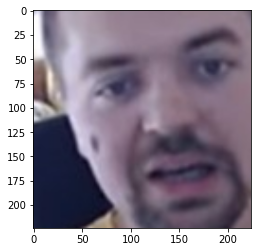

/content/drive/MyDrive/PS/final_ds/agadmators_09.jpg
1


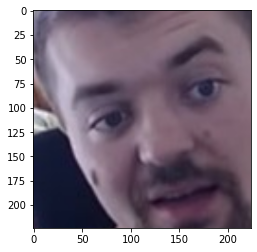

/content/drive/MyDrive/PS/final_ds/agadmators_10.jpg
2


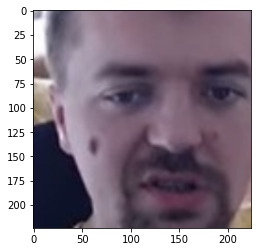

/content/drive/MyDrive/PS/final_ds/anthonyytg_08.jpg
3


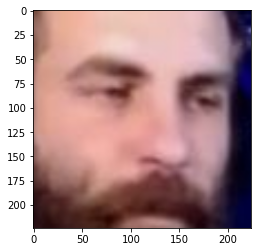

/content/drive/MyDrive/PS/final_ds/anthonyytg_09.jpg
4


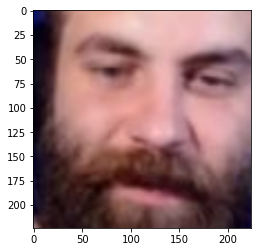

/content/drive/MyDrive/PS/final_ds/anthonyytg_10.jpg
5


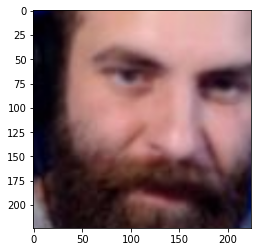

/content/drive/MyDrive/PS/final_ds/Azfura_08.jpg
6


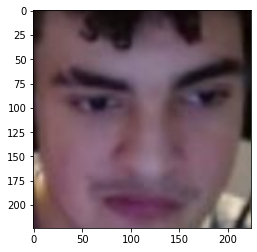

/content/drive/MyDrive/PS/final_ds/Azfura_09.jpg
7


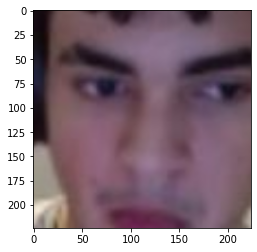

/content/drive/MyDrive/PS/final_ds/Azfura_10.jpg
8


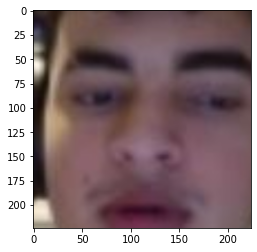

/content/drive/MyDrive/PS/final_ds/calango_08.jpg
9


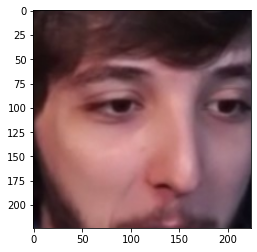

/content/drive/MyDrive/PS/final_ds/calango_09.jpg
10


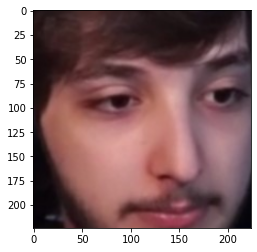

/content/drive/MyDrive/PS/final_ds/calango_10.jpg
11


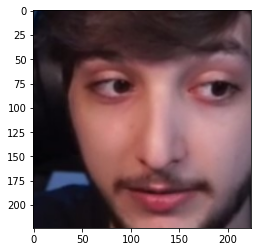

/content/drive/MyDrive/PS/final_ds/Canko_08.jpg
12


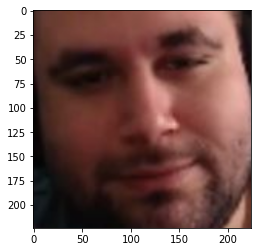

/content/drive/MyDrive/PS/final_ds/Canko_09.jpg
13


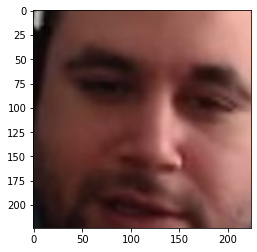

/content/drive/MyDrive/PS/final_ds/Canko_10.jpg
14


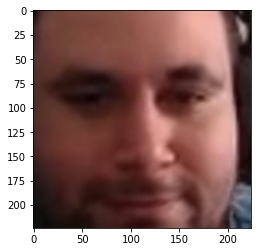

/content/drive/MyDrive/PS/final_ds/Cinar_08.jpg
15


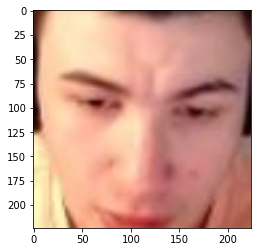

/content/drive/MyDrive/PS/final_ds/Cinar_09.jpg
16


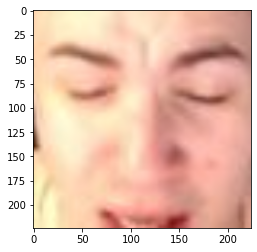

/content/drive/MyDrive/PS/final_ds/Cinar_10.jpg
17


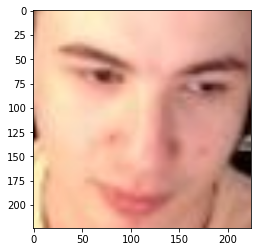

/content/drive/MyDrive/PS/final_ds/CodingEntrepreneurs_08.jpg
18


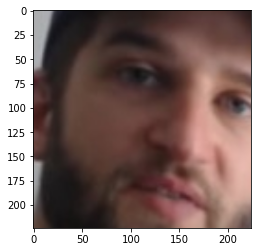

/content/drive/MyDrive/PS/final_ds/CodingEntrepreneurs_09.jpg
19


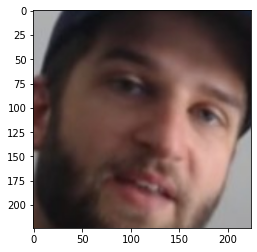

/content/drive/MyDrive/PS/final_ds/CodingEntrepreneurs_10.jpg
20


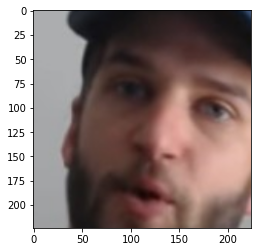

/content/drive/MyDrive/PS/final_ds/CrypticRileyy_10.jpg
21


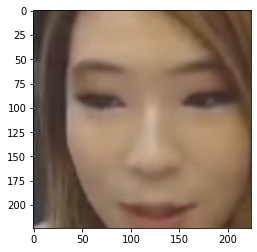

/content/drive/MyDrive/PS/final_ds/FeiTV_08.jpg
22


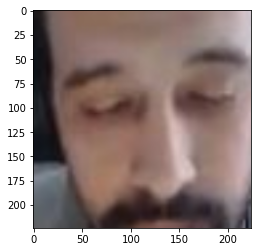

/content/drive/MyDrive/PS/final_ds/FeiTV_09.jpg
23


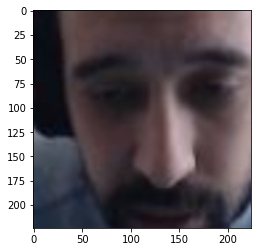

/content/drive/MyDrive/PS/final_ds/FeiTV_10.jpg
24


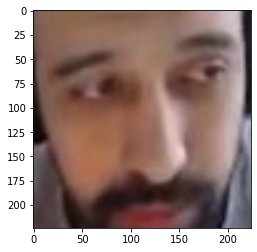

/content/drive/MyDrive/PS/final_ds/FIRATalbert_08.jpg
25


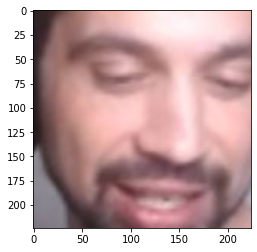

/content/drive/MyDrive/PS/final_ds/FIRATalbert_09.jpg
26


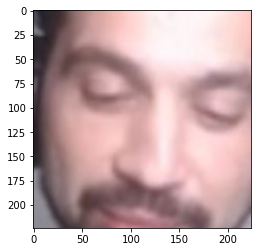

/content/drive/MyDrive/PS/final_ds/FIRATalbert_10.jpg
27


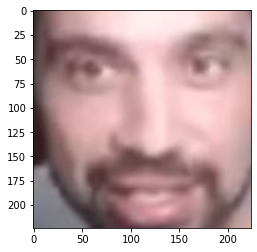

/content/drive/MyDrive/PS/final_ds/MamaSwiggi_08.jpg
28


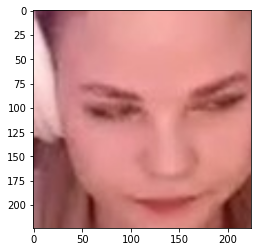

/content/drive/MyDrive/PS/final_ds/MamaSwiggi_09.jpg
29


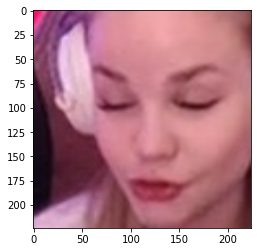

/content/drive/MyDrive/PS/final_ds/MamaSwiggi_10.jpg
30


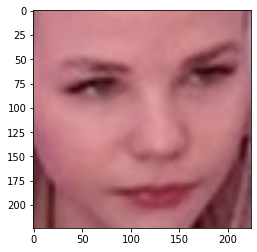

/content/drive/MyDrive/PS/final_ds/Misuink_08.jpg
31


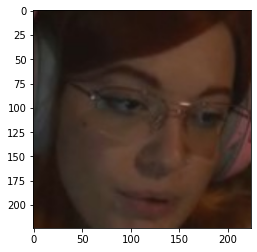

/content/drive/MyDrive/PS/final_ds/Misuink_09.jpg
32


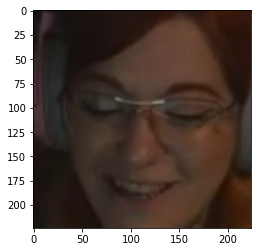

/content/drive/MyDrive/PS/final_ds/Misuink_10.jpg
33


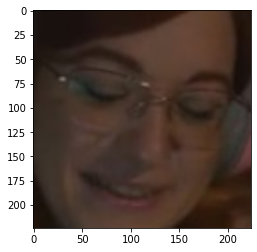

/content/drive/MyDrive/PS/final_ds/mrbeast_08.jpg
34


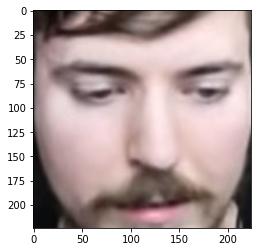

/content/drive/MyDrive/PS/final_ds/mrbeast_09.jpg
35


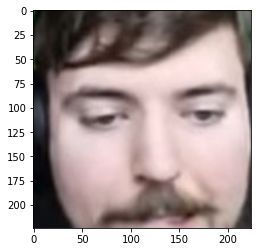

/content/drive/MyDrive/PS/final_ds/mrbeast_10.jpg
36


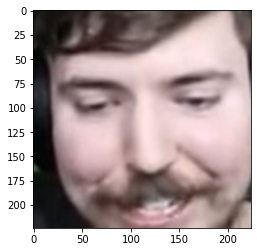

/content/drive/MyDrive/PS/final_ds/NathanPlayZ03_08.jpg
37


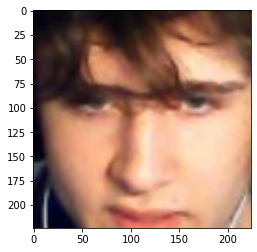

/content/drive/MyDrive/PS/final_ds/NathanPlayZ03_09.jpg
38


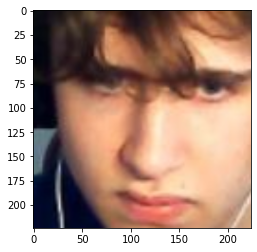

/content/drive/MyDrive/PS/final_ds/NathanPlayZ03_10.jpg
39


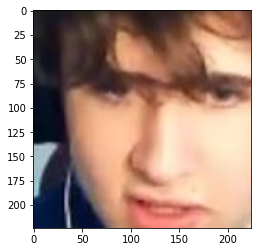

/content/drive/MyDrive/PS/final_ds/nelyaray_08.jpg
40


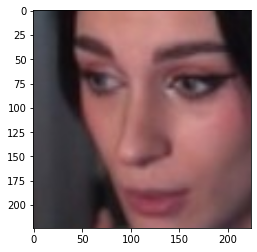

/content/drive/MyDrive/PS/final_ds/nelyaray_09.jpg
41


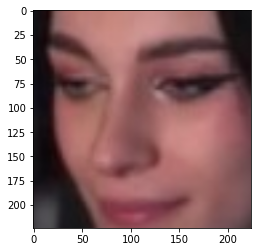

/content/drive/MyDrive/PS/final_ds/nelyaray_10.jpg
42


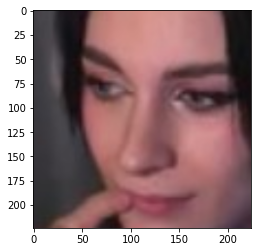

/content/drive/MyDrive/PS/final_ds/Pers0003_06.png
43


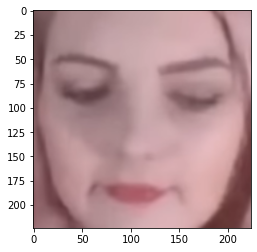

/content/drive/MyDrive/PS/final_ds/Pers0003_07.png
44


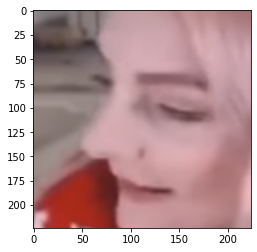

/content/drive/MyDrive/PS/final_ds/Pers0003_08.png
45


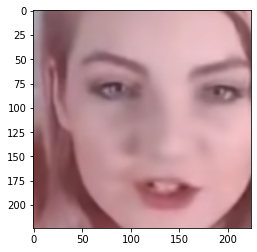

/content/drive/MyDrive/PS/final_ds/Pers0003_09.png
46


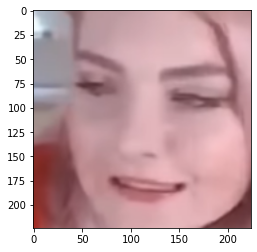

/content/drive/MyDrive/PS/final_ds/Pers0003_10.png
47


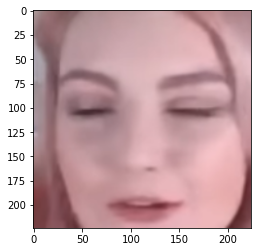

/content/drive/MyDrive/PS/final_ds/Pers0005_06.png
48


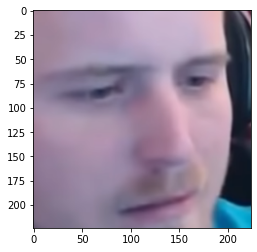

/content/drive/MyDrive/PS/final_ds/Pers0005_07.png
49


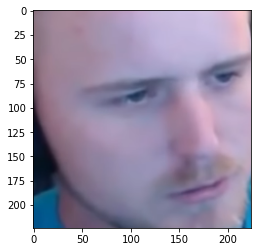

/content/drive/MyDrive/PS/final_ds/Pers0005_08.png
50


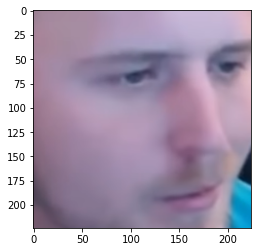

/content/drive/MyDrive/PS/final_ds/Pers0005_09.png
51


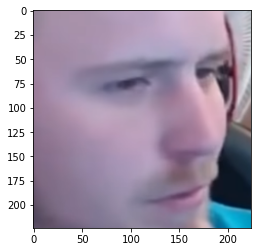

/content/drive/MyDrive/PS/final_ds/Pers0005_10.png
52


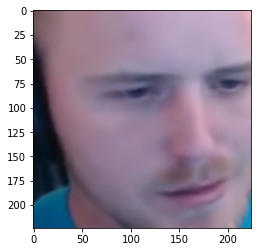

/content/drive/MyDrive/PS/final_ds/Pers0009_06.png
53


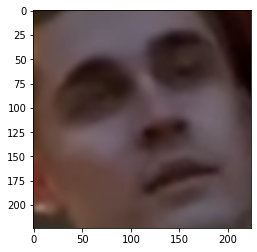

/content/drive/MyDrive/PS/final_ds/Pers0009_07.png
54


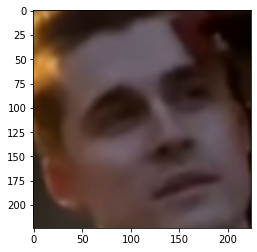

/content/drive/MyDrive/PS/final_ds/Pers0009_08.png
55


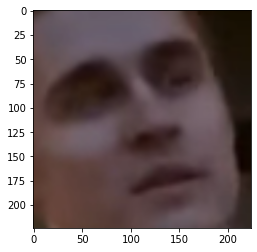

/content/drive/MyDrive/PS/final_ds/Pers0009_09.png
56


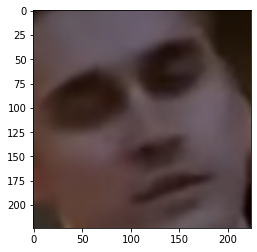

/content/drive/MyDrive/PS/final_ds/Pers0009_10.png
57


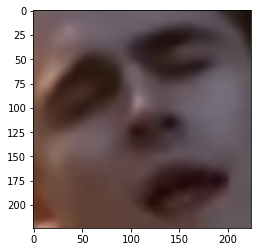

/content/drive/MyDrive/PS/final_ds/Pers0011_06.png
58


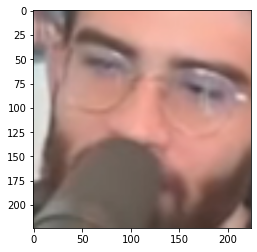

/content/drive/MyDrive/PS/final_ds/Pers0011_07.png
59


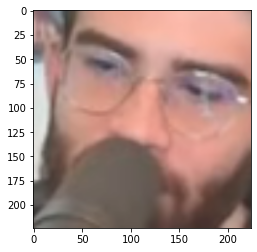

/content/drive/MyDrive/PS/final_ds/Pers0011_08.png
60


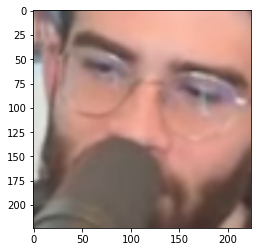

/content/drive/MyDrive/PS/final_ds/Pers0011_09.png
61


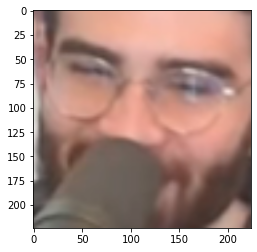

/content/drive/MyDrive/PS/final_ds/Pers0011_10.png
62


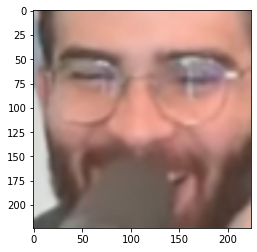

/content/drive/MyDrive/PS/final_ds/Pers0015_06.png
63


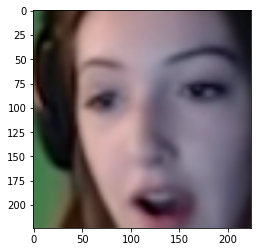

/content/drive/MyDrive/PS/final_ds/Pers0015_07.png
64
/content/drive/MyDrive/PS/final_ds/Pers0015_08.png
65


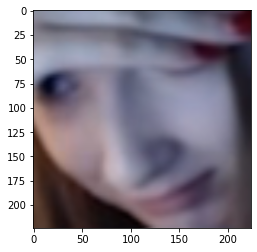

/content/drive/MyDrive/PS/final_ds/Pers0015_09.png
66


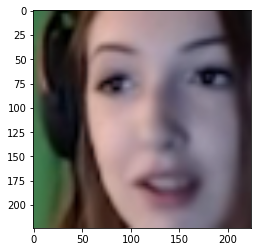

/content/drive/MyDrive/PS/final_ds/Pers0015_10.png
67


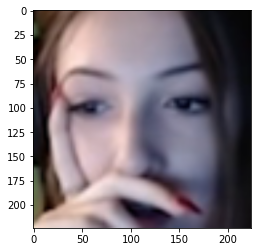

/content/drive/MyDrive/PS/final_ds/Pers0017_06.png
68


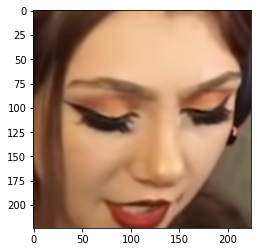

/content/drive/MyDrive/PS/final_ds/Pers0017_07.png
69


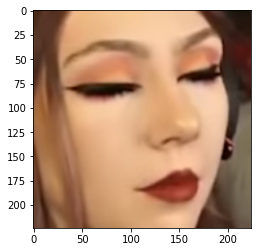

/content/drive/MyDrive/PS/final_ds/Pers0017_08.png
70


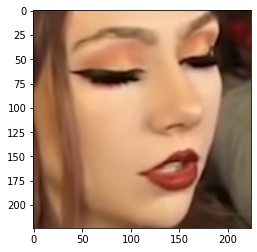

/content/drive/MyDrive/PS/final_ds/Pers0017_09.png
71


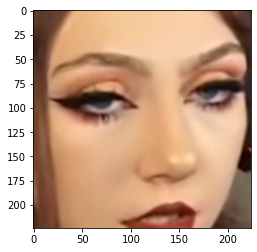

/content/drive/MyDrive/PS/final_ds/Pers0017_10.png
72


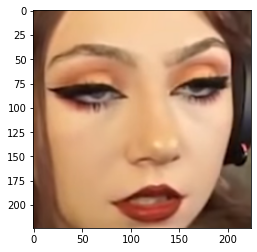

/content/drive/MyDrive/PS/final_ds/Pers0021_06.png
73


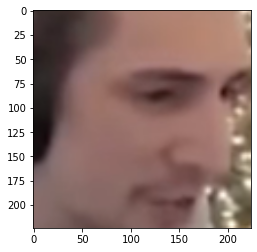

/content/drive/MyDrive/PS/final_ds/Pers0021_07.png
74


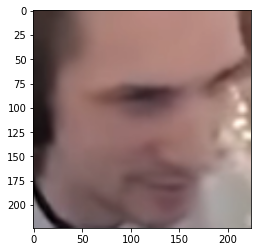

/content/drive/MyDrive/PS/final_ds/Pers0021_08.png
75


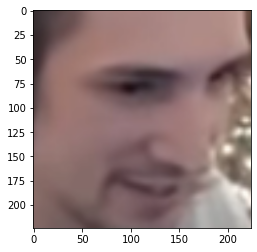

/content/drive/MyDrive/PS/final_ds/Pers0021_09.png
76


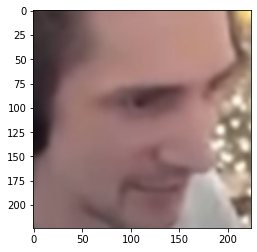

/content/drive/MyDrive/PS/final_ds/Pers0021_10.png
77


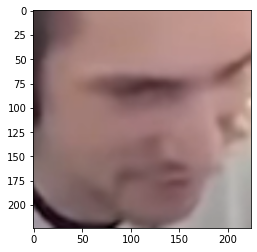

/content/drive/MyDrive/PS/final_ds/Pers0023_06.png
78


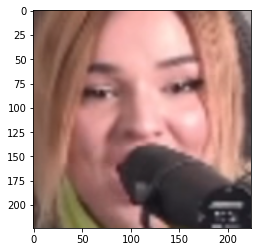

/content/drive/MyDrive/PS/final_ds/Pers0023_07.png
79


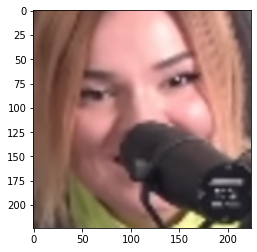

/content/drive/MyDrive/PS/final_ds/Pers0023_08.png
80


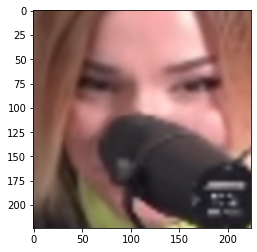

/content/drive/MyDrive/PS/final_ds/Pers0023_09.png
81


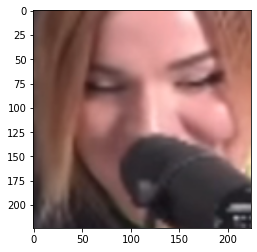

/content/drive/MyDrive/PS/final_ds/Pers0023_10.png
82


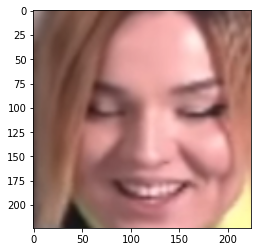

/content/drive/MyDrive/PS/final_ds/Pers0027_06.png
83


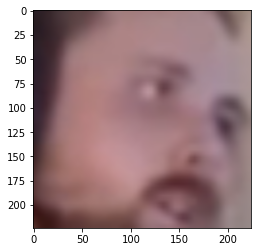

/content/drive/MyDrive/PS/final_ds/Pers0027_07.png
84


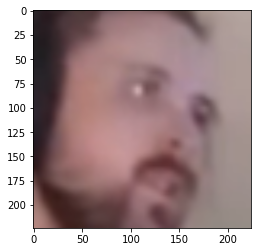

/content/drive/MyDrive/PS/final_ds/Pers0027_08.png
85


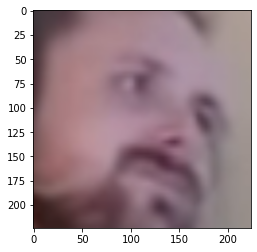

/content/drive/MyDrive/PS/final_ds/Pers0027_09.png
86


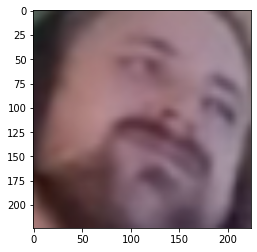

/content/drive/MyDrive/PS/final_ds/Pers0027_10.png
87


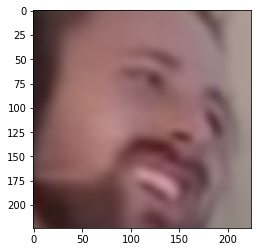

/content/drive/MyDrive/PS/final_ds/Pers0029_06.png
88


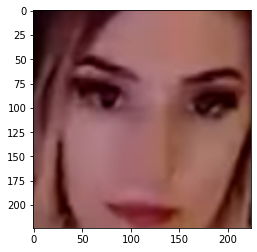

/content/drive/MyDrive/PS/final_ds/Pers0029_07.png
89


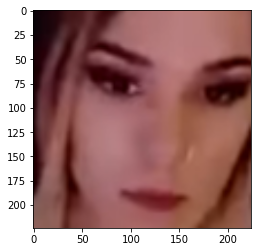

/content/drive/MyDrive/PS/final_ds/Pers0029_08.png
90


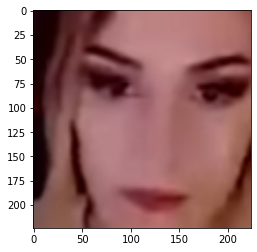

/content/drive/MyDrive/PS/final_ds/Pers0029_09.png
91


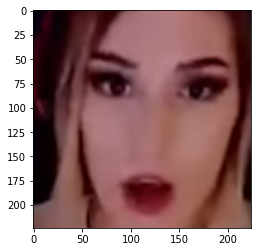

/content/drive/MyDrive/PS/final_ds/Pers0029_10.png
92


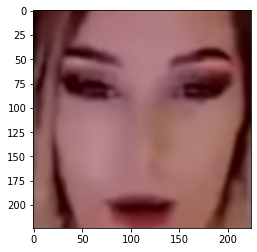

/content/drive/MyDrive/PS/final_ds/Pers0033_06.png
93


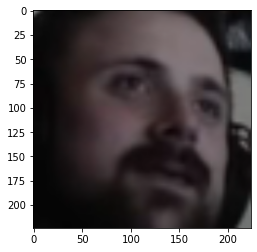

/content/drive/MyDrive/PS/final_ds/Pers0033_07.png
94


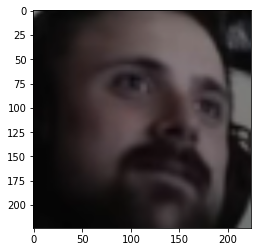

/content/drive/MyDrive/PS/final_ds/Pers0033_08.png
95


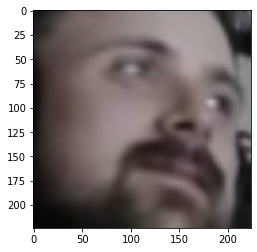

/content/drive/MyDrive/PS/final_ds/Pers0033_09.png
96


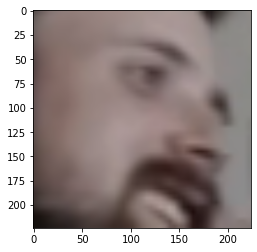

/content/drive/MyDrive/PS/final_ds/Pers0033_10.png
97


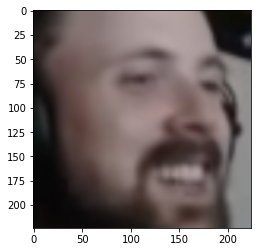

/content/drive/MyDrive/PS/final_ds/Pers0035_06.png
98


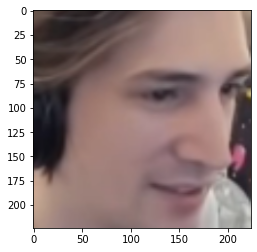

/content/drive/MyDrive/PS/final_ds/Pers0035_07.png
99


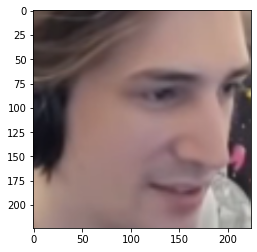

/content/drive/MyDrive/PS/final_ds/Pers0035_08.png
100


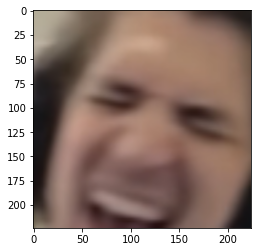

/content/drive/MyDrive/PS/final_ds/Pers0035_09.png
101


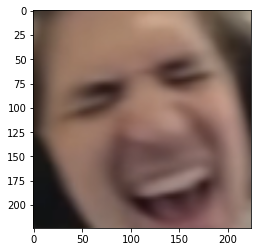

/content/drive/MyDrive/PS/final_ds/Pers0035_10.png
102


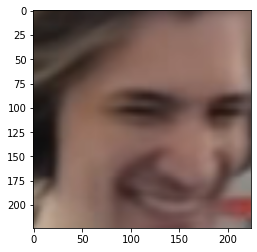

/content/drive/MyDrive/PS/final_ds/Pers0039_06.png
103


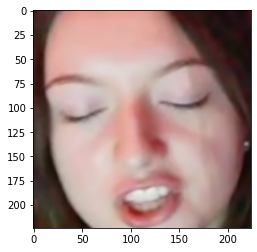

/content/drive/MyDrive/PS/final_ds/Pers0039_07.png
104


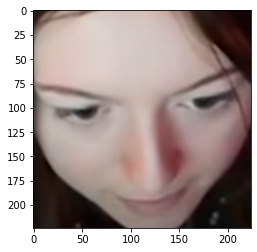

/content/drive/MyDrive/PS/final_ds/Pers0039_08.png
105


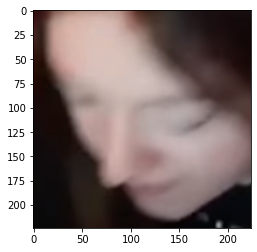

/content/drive/MyDrive/PS/final_ds/Pers0039_09.png
106


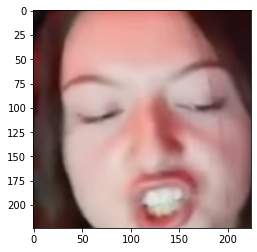

/content/drive/MyDrive/PS/final_ds/Pers0039_10.png
107


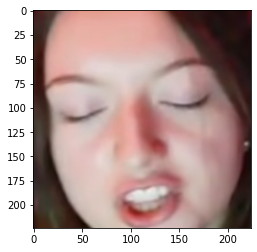

/content/drive/MyDrive/PS/final_ds/Pers0041_06.png
108


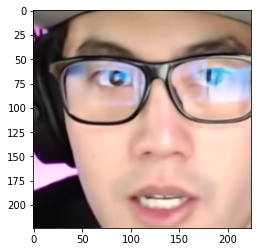

/content/drive/MyDrive/PS/final_ds/Pers0041_07.png
109


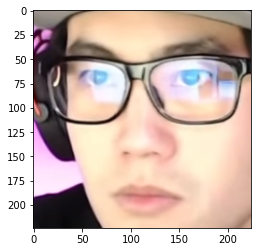

/content/drive/MyDrive/PS/final_ds/Pers0041_08.png
110


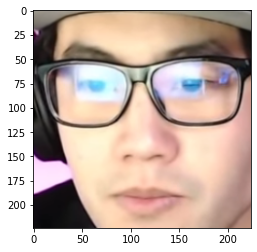

/content/drive/MyDrive/PS/final_ds/Pers0041_09.png
111


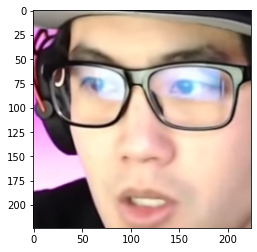

/content/drive/MyDrive/PS/final_ds/Pers0041_10.png
112


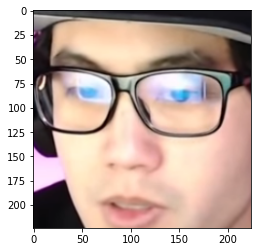

/content/drive/MyDrive/PS/final_ds/Pers0045_06.png
113


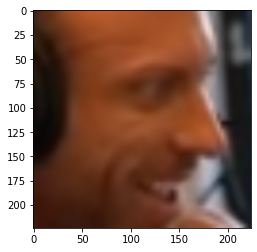

/content/drive/MyDrive/PS/final_ds/Pers0045_07.png
114


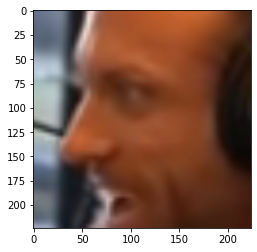

/content/drive/MyDrive/PS/final_ds/Pers0045_08.png
115


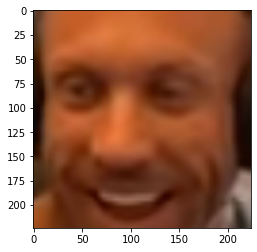

/content/drive/MyDrive/PS/final_ds/Pers0045_09.png
116


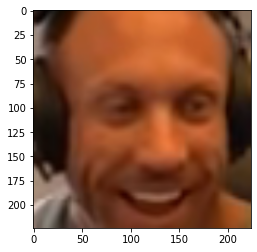

/content/drive/MyDrive/PS/final_ds/Pers0045_10.png
117


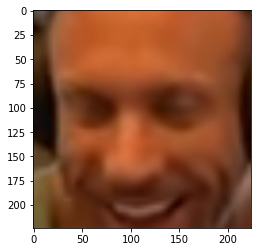

/content/drive/MyDrive/PS/final_ds/Pers0047_06.png
118


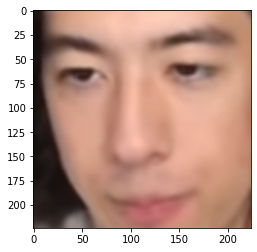

/content/drive/MyDrive/PS/final_ds/Pers0047_07.png
119


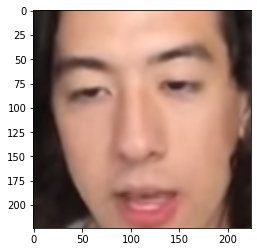

/content/drive/MyDrive/PS/final_ds/Pers0047_08.png
120


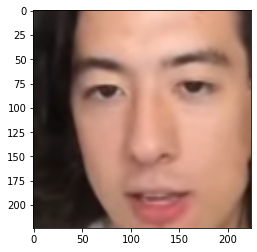

/content/drive/MyDrive/PS/final_ds/Pers0047_09.png
121


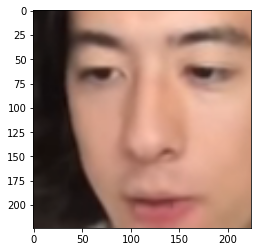

/content/drive/MyDrive/PS/final_ds/Pers0047_10.png
122


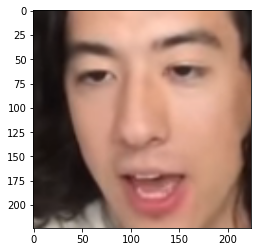

/content/drive/MyDrive/PS/final_ds/Pers0051_06.png
123


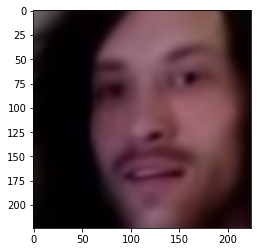

/content/drive/MyDrive/PS/final_ds/Pers0051_07.png
124


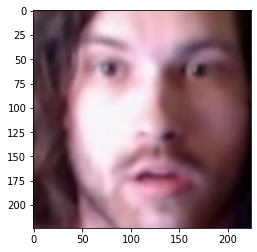

/content/drive/MyDrive/PS/final_ds/Pers0051_08.png
125


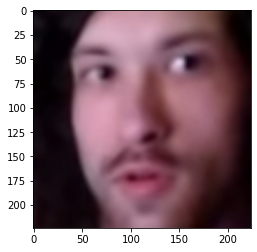

/content/drive/MyDrive/PS/final_ds/Pers0051_09.png
126


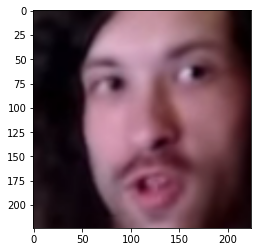

/content/drive/MyDrive/PS/final_ds/Pers0051_10.png
127


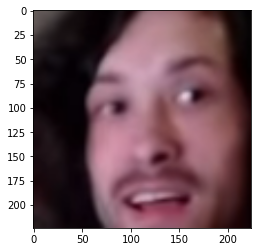

/content/drive/MyDrive/PS/final_ds/Pers0053_06.png
128


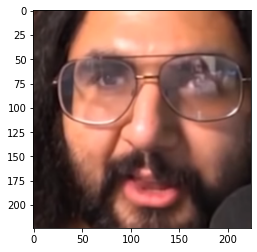

/content/drive/MyDrive/PS/final_ds/Pers0053_07.png
129


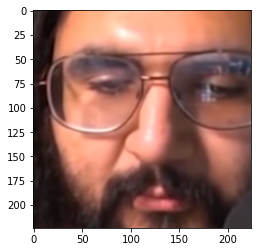

/content/drive/MyDrive/PS/final_ds/Pers0053_08.png
130


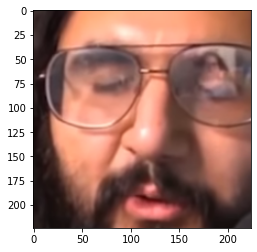

/content/drive/MyDrive/PS/final_ds/Pers0053_09.png
131


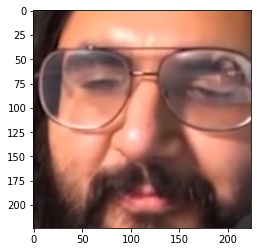

/content/drive/MyDrive/PS/final_ds/Pers0053_10.png
132


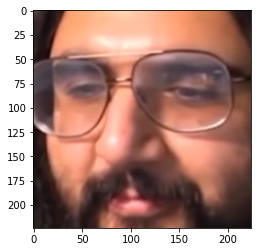

/content/drive/MyDrive/PS/final_ds/Pers0057_06.png
133


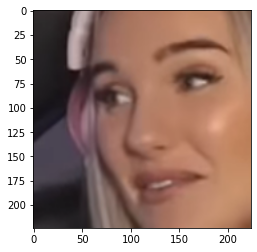

/content/drive/MyDrive/PS/final_ds/Pers0057_07.png
134


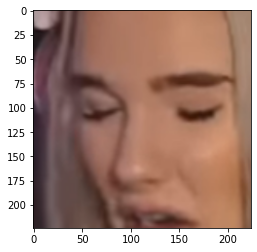

/content/drive/MyDrive/PS/final_ds/Pers0057_08.png
135


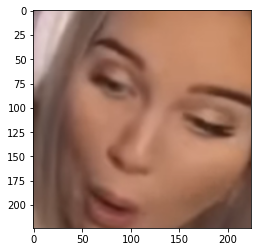

/content/drive/MyDrive/PS/final_ds/Pers0057_09.png
136


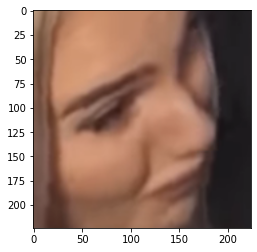

/content/drive/MyDrive/PS/final_ds/Pers0057_10.png
137


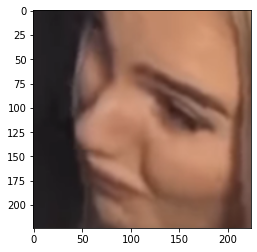

/content/drive/MyDrive/PS/final_ds/Pers0059_06.png
138


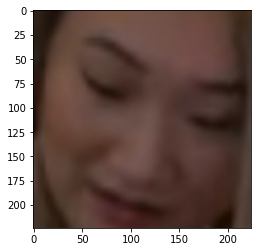

/content/drive/MyDrive/PS/final_ds/Pers0059_07.png
139


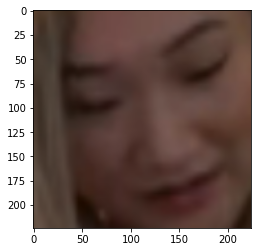

/content/drive/MyDrive/PS/final_ds/Pers0059_08.png
140


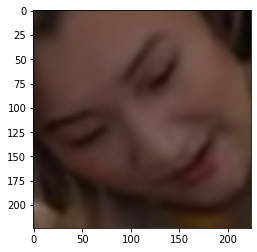

/content/drive/MyDrive/PS/final_ds/Pers0059_09.png
141


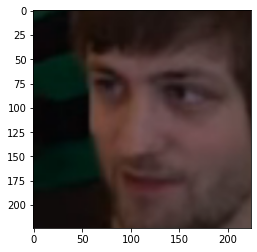

/content/drive/MyDrive/PS/final_ds/Pers0059_10.png
142


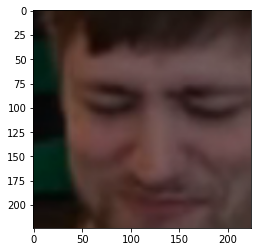

/content/drive/MyDrive/PS/final_ds/Pers0063_06.png
143


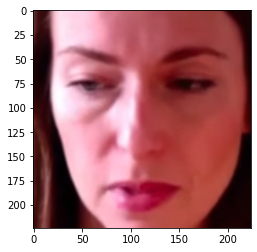

/content/drive/MyDrive/PS/final_ds/Pers0063_07.png
144


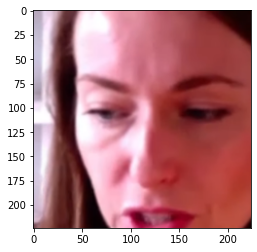

/content/drive/MyDrive/PS/final_ds/Pers0063_08.png
145


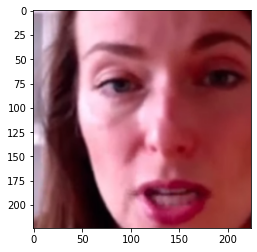

/content/drive/MyDrive/PS/final_ds/Pers0063_09.png
146


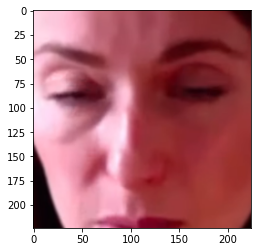

/content/drive/MyDrive/PS/final_ds/Pers0063_10.png
147


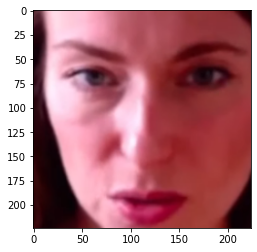

/content/drive/MyDrive/PS/final_ds/Pers0065_06.png
148


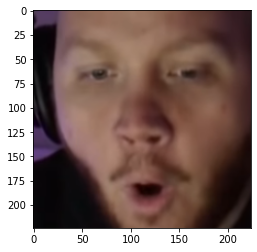

/content/drive/MyDrive/PS/final_ds/Pers0065_07.png
149


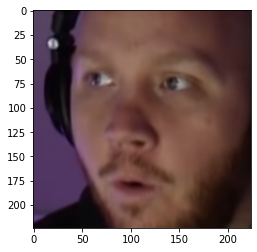

/content/drive/MyDrive/PS/final_ds/Pers0065_08.png
150


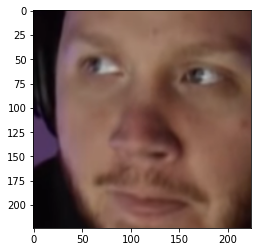

/content/drive/MyDrive/PS/final_ds/Pers0065_09.png
151


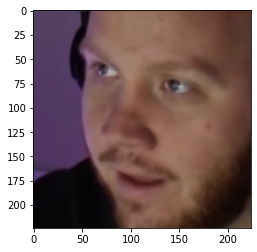

/content/drive/MyDrive/PS/final_ds/Pers0065_10.png
152


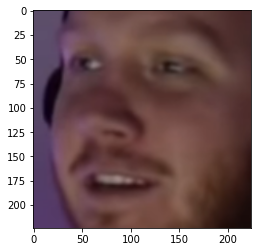

/content/drive/MyDrive/PS/final_ds/Pers0069_06.png
153


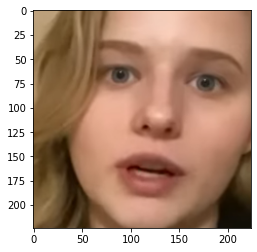

/content/drive/MyDrive/PS/final_ds/Pers0069_07.png
154


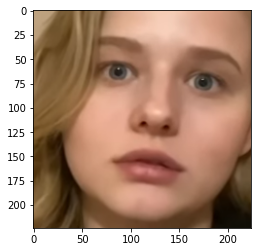

/content/drive/MyDrive/PS/final_ds/Pers0069_08.png
155


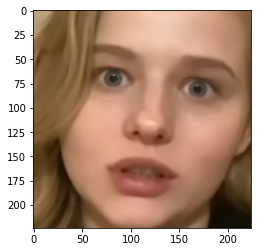

/content/drive/MyDrive/PS/final_ds/Pers0069_09.png
156


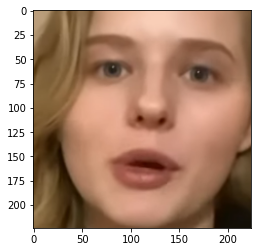

/content/drive/MyDrive/PS/final_ds/Pers0069_10.png
157


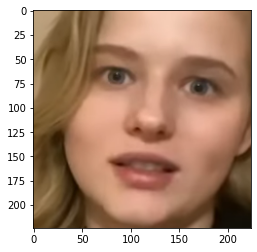

/content/drive/MyDrive/PS/final_ds/Pers0071_06.png
158


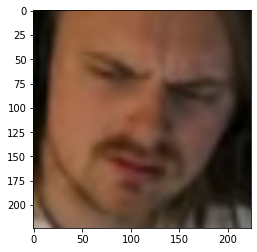

/content/drive/MyDrive/PS/final_ds/Pers0071_07.png
159


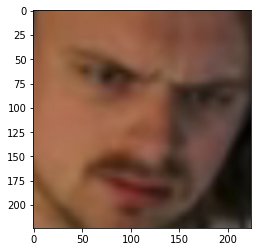

/content/drive/MyDrive/PS/final_ds/Pers0071_08.png
160


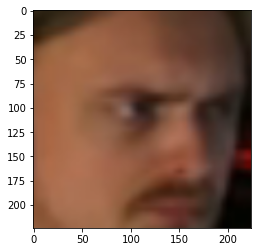

/content/drive/MyDrive/PS/final_ds/Pers0071_09.png
161


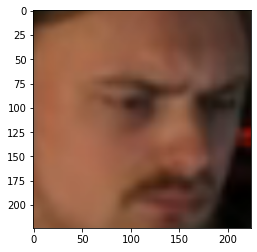

/content/drive/MyDrive/PS/final_ds/Pers0071_10.png
162


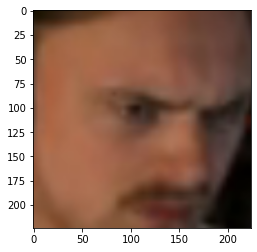

/content/drive/MyDrive/PS/final_ds/Pers0075_06.png
163
/content/drive/MyDrive/PS/final_ds/Pers0075_07.png
164
/content/drive/MyDrive/PS/final_ds/Pers0075_08.png
165
/content/drive/MyDrive/PS/final_ds/Pers0075_09.png
166
/content/drive/MyDrive/PS/final_ds/Pers0075_10.png
167
/content/drive/MyDrive/PS/final_ds/Pers0077_06.png
168


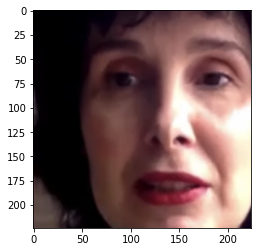

/content/drive/MyDrive/PS/final_ds/Pers0077_07.png
169


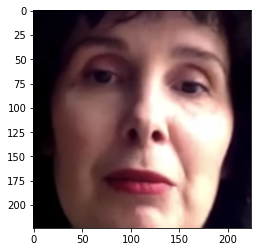

/content/drive/MyDrive/PS/final_ds/Pers0077_08.png
170


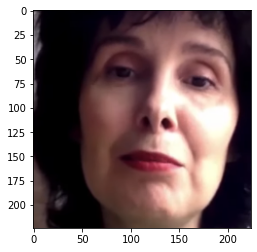

/content/drive/MyDrive/PS/final_ds/Pers0077_09.png
171


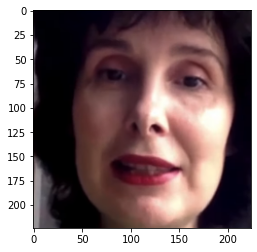

/content/drive/MyDrive/PS/final_ds/Pers0077_10.png
172


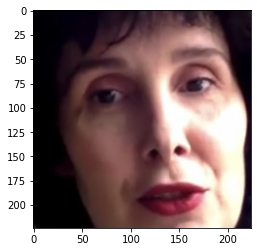

/content/drive/MyDrive/PS/final_ds/Pers0081_06.png
173


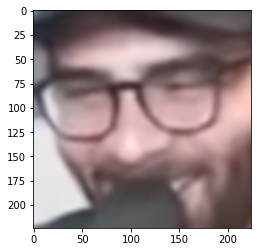

/content/drive/MyDrive/PS/final_ds/Pers0081_07.png
174


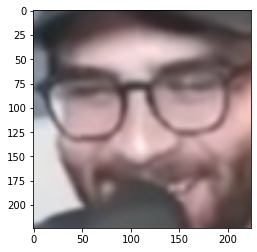

/content/drive/MyDrive/PS/final_ds/Pers0081_08.png
175


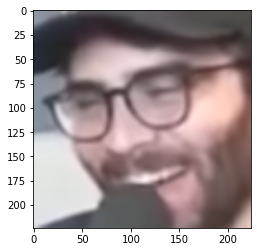

/content/drive/MyDrive/PS/final_ds/Pers0081_09.png
176


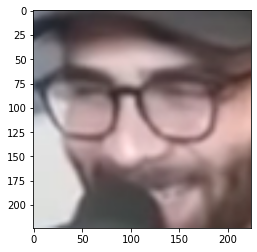

/content/drive/MyDrive/PS/final_ds/Pers0081_10.png
177


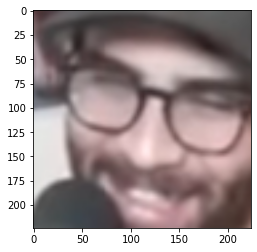

/content/drive/MyDrive/PS/final_ds/Pers0083_06.png
178


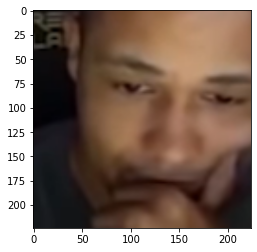

/content/drive/MyDrive/PS/final_ds/Pers0083_07.png
179


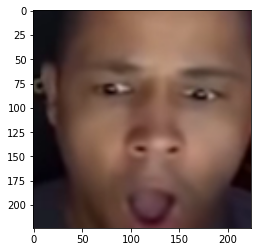

/content/drive/MyDrive/PS/final_ds/Pers0083_08.png
180


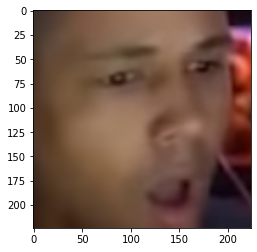

/content/drive/MyDrive/PS/final_ds/Pers0083_09.png
181


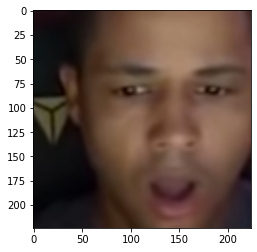

/content/drive/MyDrive/PS/final_ds/Pers0083_10.png
182
/content/drive/MyDrive/PS/final_ds/Pers0087_06.png
183


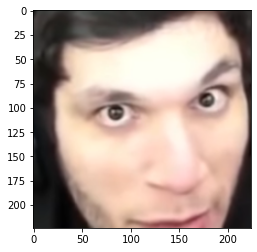

/content/drive/MyDrive/PS/final_ds/Pers0087_07.png
184


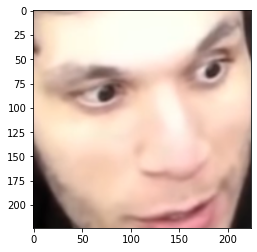

/content/drive/MyDrive/PS/final_ds/Pers0087_08.png
185


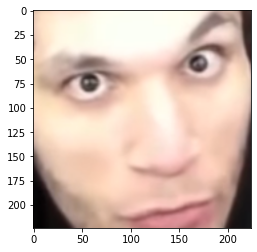

/content/drive/MyDrive/PS/final_ds/Pers0087_09.png
186


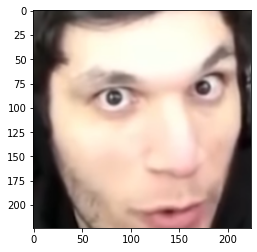

/content/drive/MyDrive/PS/final_ds/Pers0087_10.png
187


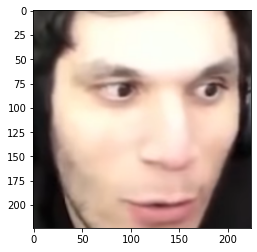

/content/drive/MyDrive/PS/final_ds/Pers0089_06.png
188


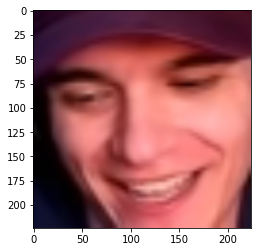

/content/drive/MyDrive/PS/final_ds/Pers0089_07.png
189


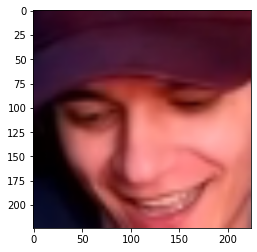

/content/drive/MyDrive/PS/final_ds/Pers0089_08.png
190


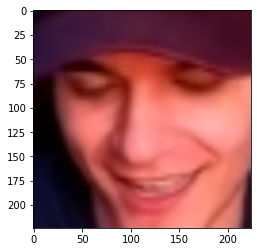

/content/drive/MyDrive/PS/final_ds/Pers0089_09.png
191


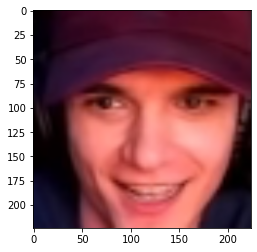

/content/drive/MyDrive/PS/final_ds/Pers0089_10.png
192


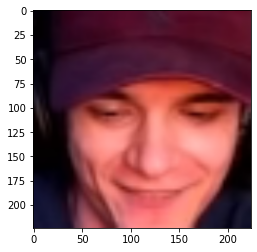

/content/drive/MyDrive/PS/final_ds/Pers0093_06.png
193


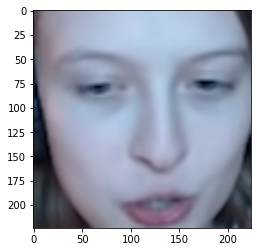

/content/drive/MyDrive/PS/final_ds/Pers0093_07.png
194


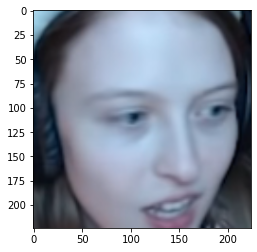

/content/drive/MyDrive/PS/final_ds/Pers0093_08.png
195


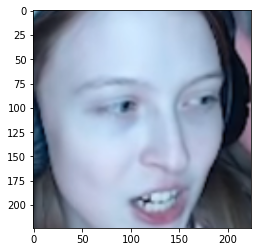

/content/drive/MyDrive/PS/final_ds/Pers0093_09.png
196


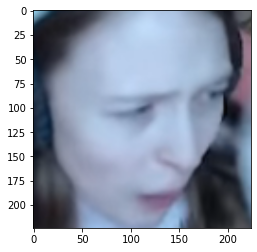

/content/drive/MyDrive/PS/final_ds/Pers0093_10.png
197


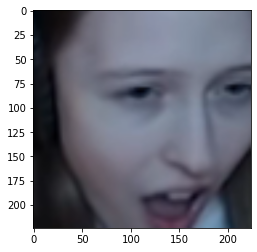

/content/drive/MyDrive/PS/final_ds/Pers0095_06.png
198


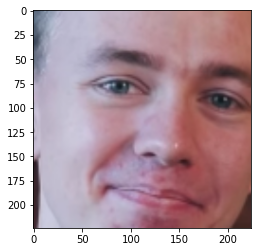

/content/drive/MyDrive/PS/final_ds/Pers0095_07.png
199


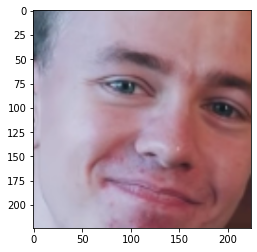

/content/drive/MyDrive/PS/final_ds/Pers0095_08.png
200


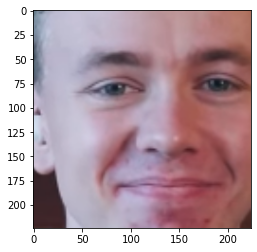

/content/drive/MyDrive/PS/final_ds/Pers0095_09.png
201


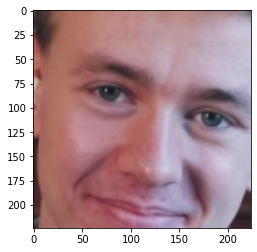

/content/drive/MyDrive/PS/final_ds/Pers0095_10.png
202


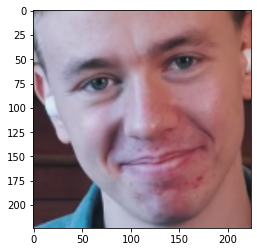

/content/drive/MyDrive/PS/final_ds/Pers0099_06.png
203


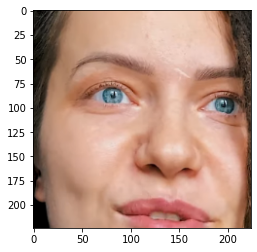

/content/drive/MyDrive/PS/final_ds/Pers0099_07.png
204


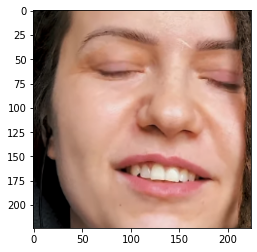

/content/drive/MyDrive/PS/final_ds/Pers0099_08.png
205


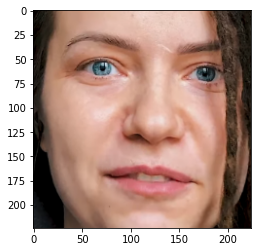

/content/drive/MyDrive/PS/final_ds/Pers0099_09.png
206


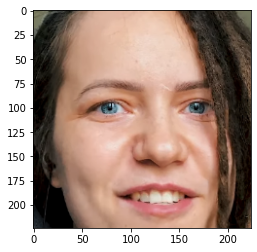

/content/drive/MyDrive/PS/final_ds/Pers0099_10.png
207


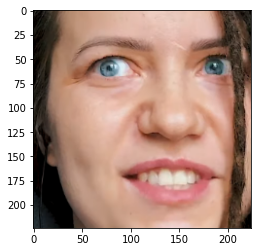

/content/drive/MyDrive/PS/final_ds/Pers0101_06.png
208


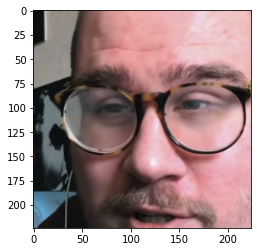

/content/drive/MyDrive/PS/final_ds/Pers0101_07.png
209


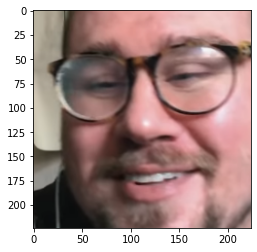

/content/drive/MyDrive/PS/final_ds/Pers0101_08.png
210


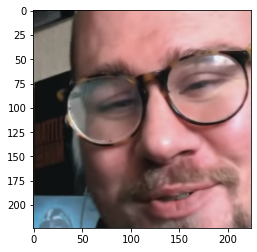

/content/drive/MyDrive/PS/final_ds/Pers0101_09.png
211


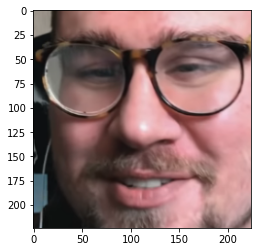

/content/drive/MyDrive/PS/final_ds/Pers0101_10.png
212


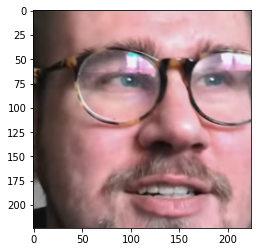

/content/drive/MyDrive/PS/final_ds/Pers0105_06.png
213


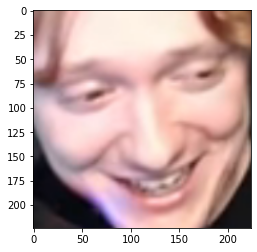

/content/drive/MyDrive/PS/final_ds/Pers0105_07.png
214


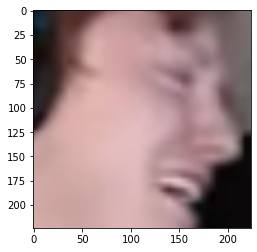

/content/drive/MyDrive/PS/final_ds/Pers0105_08.png
215


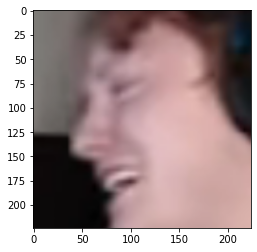

/content/drive/MyDrive/PS/final_ds/Pers0105_09.png
216


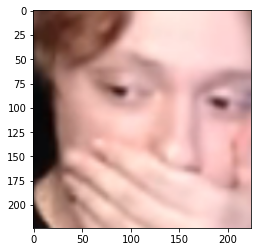

/content/drive/MyDrive/PS/final_ds/Pers0105_10.png
217


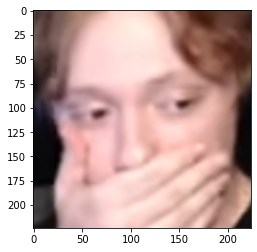

/content/drive/MyDrive/PS/final_ds/Pers0107_06.png
218


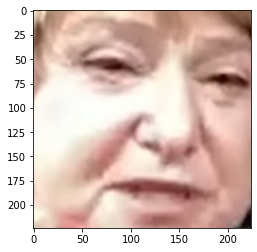

/content/drive/MyDrive/PS/final_ds/Pers0107_07.png
219


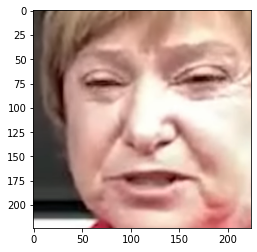

/content/drive/MyDrive/PS/final_ds/Pers0107_08.png
220


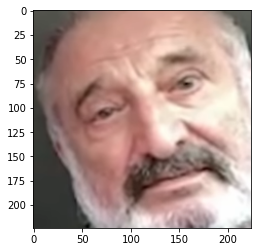

/content/drive/MyDrive/PS/final_ds/Pers0107_09.png
221


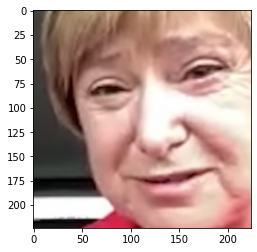

/content/drive/MyDrive/PS/final_ds/Pers0107_10.png
222


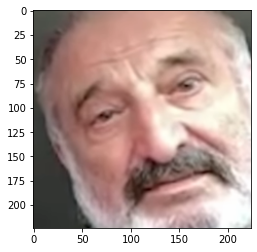

/content/drive/MyDrive/PS/final_ds/Pers0111_06.png
223


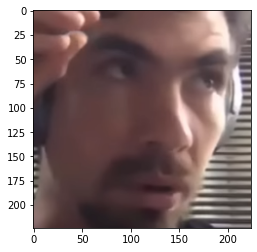

/content/drive/MyDrive/PS/final_ds/Pers0111_07.png
224


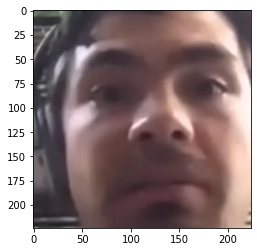

/content/drive/MyDrive/PS/final_ds/Pers0111_08.png
225


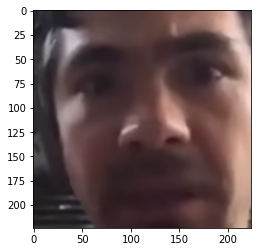

/content/drive/MyDrive/PS/final_ds/Pers0111_09.png
226


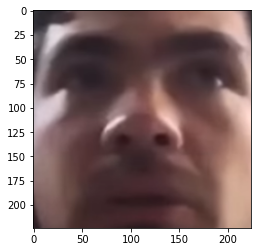

/content/drive/MyDrive/PS/final_ds/Pers0111_10.png
227


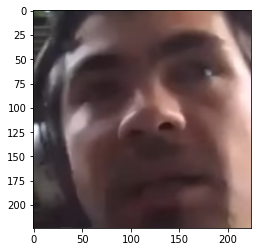

/content/drive/MyDrive/PS/final_ds/Pers0113_06.png
228


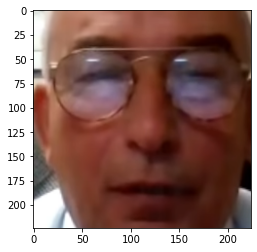

/content/drive/MyDrive/PS/final_ds/Pers0113_07.png
229


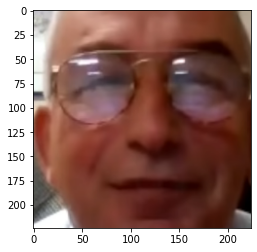

/content/drive/MyDrive/PS/final_ds/Pers0113_08.png
230


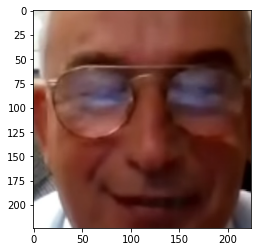

/content/drive/MyDrive/PS/final_ds/Pers0113_09.png
231


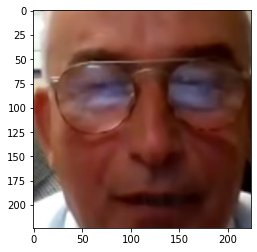

/content/drive/MyDrive/PS/final_ds/Pers0113_10.png
232


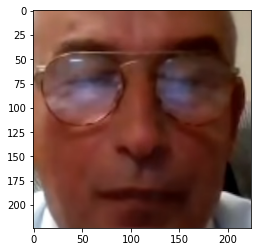

/content/drive/MyDrive/PS/final_ds/Pers0117_06.png
233


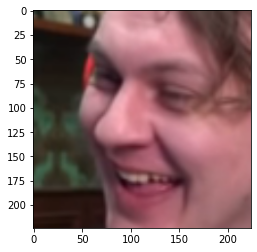

/content/drive/MyDrive/PS/final_ds/Pers0117_07.png
234


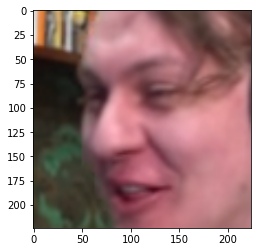

/content/drive/MyDrive/PS/final_ds/Pers0117_08.png
235


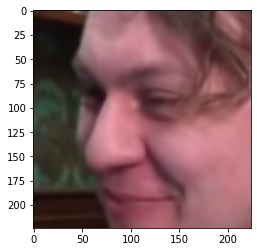

/content/drive/MyDrive/PS/final_ds/Pers0117_09.png
236


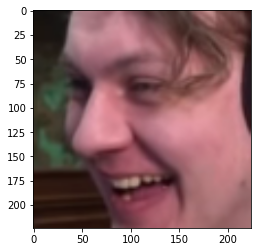

/content/drive/MyDrive/PS/final_ds/Pers0117_10.png
237


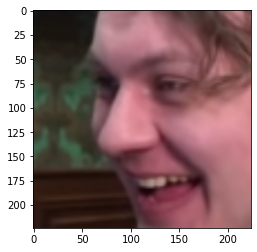

/content/drive/MyDrive/PS/final_ds/Pers0119_06.png
238


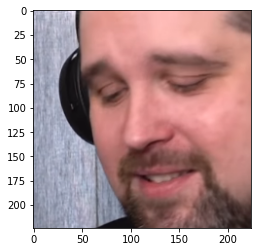

/content/drive/MyDrive/PS/final_ds/Pers0119_07.png
239


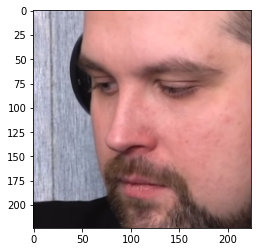

/content/drive/MyDrive/PS/final_ds/Pers0119_08.png
240


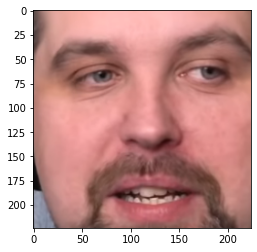

/content/drive/MyDrive/PS/final_ds/Pers0119_09.png
241


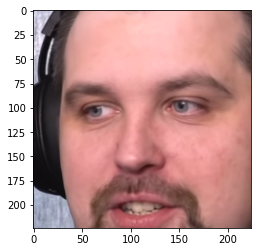

/content/drive/MyDrive/PS/final_ds/Pers0119_10.png
242


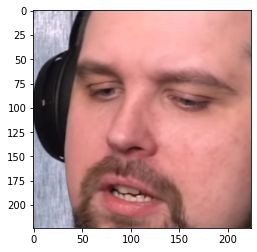

/content/drive/MyDrive/PS/final_ds/PMDkat_08.jpg
243


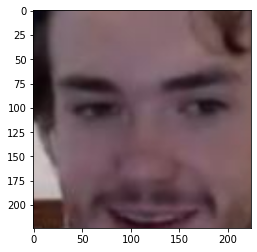

/content/drive/MyDrive/PS/final_ds/PMDkat_09.jpg
244


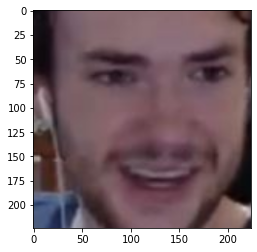

/content/drive/MyDrive/PS/final_ds/PMDkat_10.jpg
245


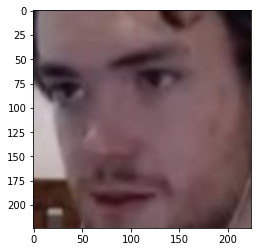

/content/drive/MyDrive/PS/final_ds/sindicsgo_08.jpg
246


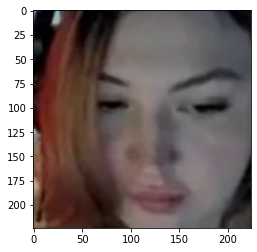

/content/drive/MyDrive/PS/final_ds/sindicsgo_09.jpg
247


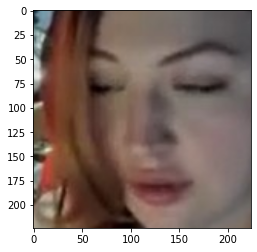

/content/drive/MyDrive/PS/final_ds/sindicsgo_10.jpg
248


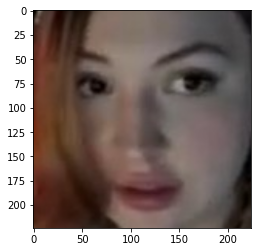

/content/drive/MyDrive/PS/final_ds/TannaGrace_08.jpg
249


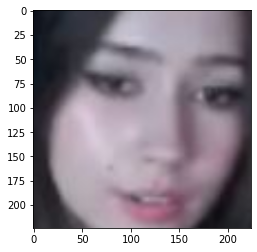

/content/drive/MyDrive/PS/final_ds/TannaGrace_09.jpg
250


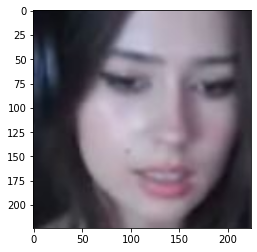

/content/drive/MyDrive/PS/final_ds/TannaGrace_10.jpg
251


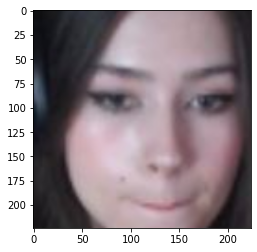

/content/drive/MyDrive/PS/final_ds/TomNyaan_08.jpg
252


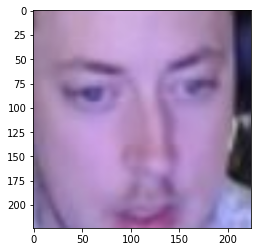

/content/drive/MyDrive/PS/final_ds/TomNyaan_09.jpg
253


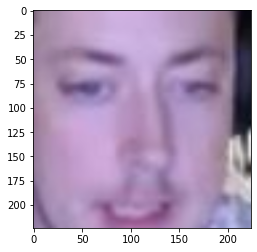

/content/drive/MyDrive/PS/final_ds/TomNyaan_10.jpg
254


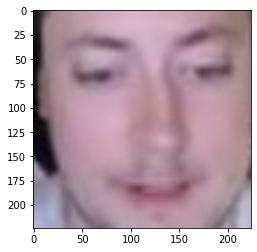

/content/drive/MyDrive/PS/final_ds/UselessMouth_08.jpg
255


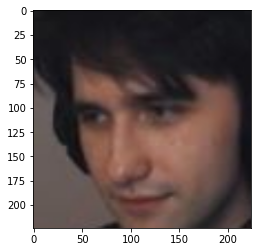

/content/drive/MyDrive/PS/final_ds/UselessMouth_09.jpg
256


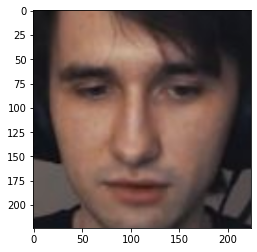

/content/drive/MyDrive/PS/final_ds/UselessMouth_10.jpg
257


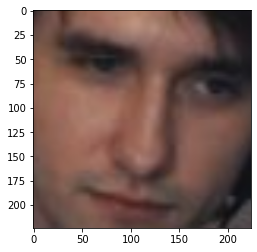

/content/drive/MyDrive/PS/final_ds/videogamer_08.jpg
258


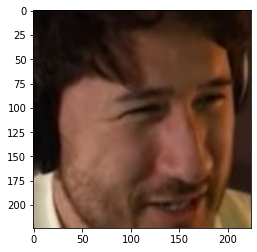

/content/drive/MyDrive/PS/final_ds/videogamer_09.jpg
259


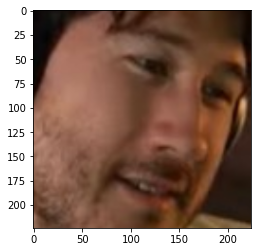

/content/drive/MyDrive/PS/final_ds/videogamer_10.jpg
260


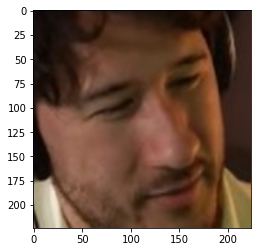

/content/drive/MyDrive/PS/final_ds/WOL_0001.jpg
261


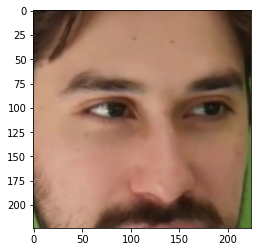

/content/drive/MyDrive/PS/final_ds/WOL_0002.jpg
262


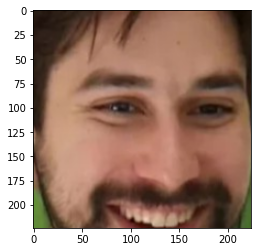

/content/drive/MyDrive/PS/final_ds/WOL_0003.jpg
263


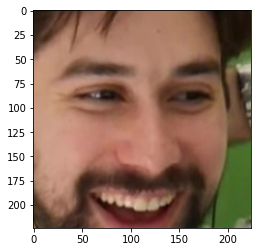

/content/drive/MyDrive/PS/final_ds/WOL_0004.jpg
264


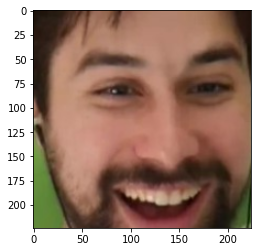

/content/drive/MyDrive/PS/final_ds/WOL_0005.jpg
265


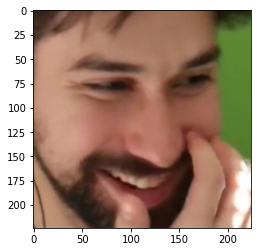

/content/drive/MyDrive/PS/final_ds/WOL_0006.jpg
266


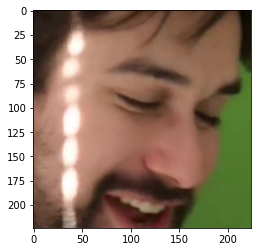

/content/drive/MyDrive/PS/final_ds/WOL_0007.jpg
267


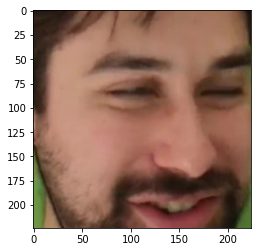

/content/drive/MyDrive/PS/final_ds/WOL_0008.jpg
268


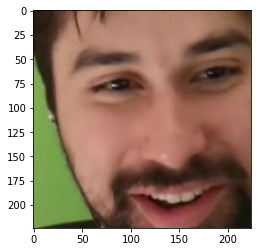

/content/drive/MyDrive/PS/final_ds/WOL_0009.jpg
269


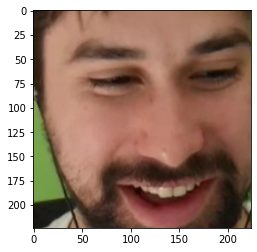

/content/drive/MyDrive/PS/final_ds/WOL_0010.jpg
270


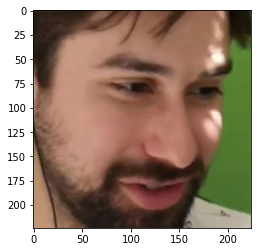

/content/drive/MyDrive/PS/final_ds/WOL_0011.jpg
271


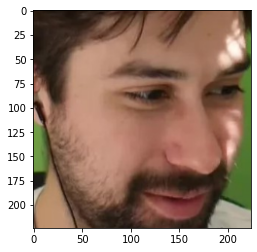

/content/drive/MyDrive/PS/final_ds/WOL_0012.jpg
272


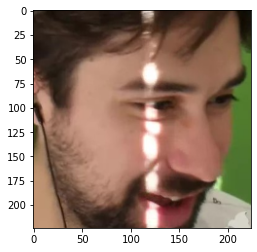

/content/drive/MyDrive/PS/final_ds/WOL_0013.jpg
273


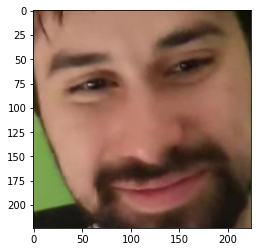

/content/drive/MyDrive/PS/final_ds/WOL_0014.jpg
274


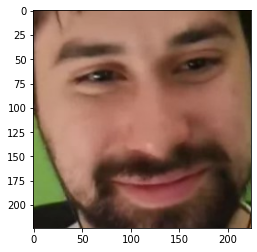

/content/drive/MyDrive/PS/final_ds/WOL_0015.jpg
275


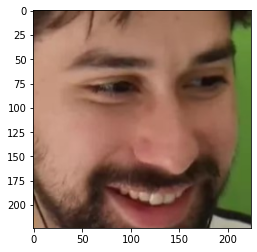

/content/drive/MyDrive/PS/final_ds/WOL_0016.jpg
276


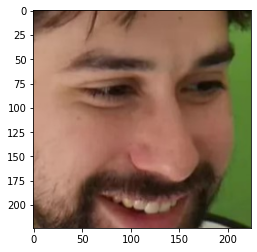

/content/drive/MyDrive/PS/final_ds/WOL_0017.jpg
277


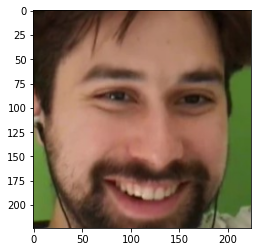

/content/drive/MyDrive/PS/final_ds/WOL_0018.jpg
278


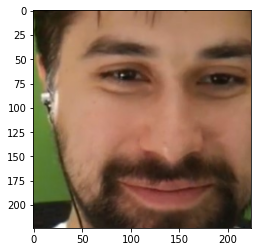

/content/drive/MyDrive/PS/final_ds/WOL_0019.jpg
279


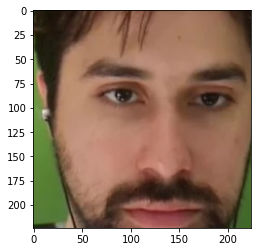

/content/drive/MyDrive/PS/final_ds/WOL_0020.jpg
280


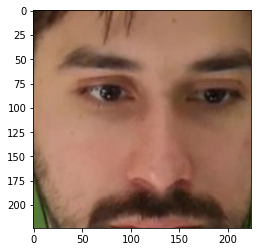

/content/drive/MyDrive/PS/final_ds/WOL_0021.jpg
281


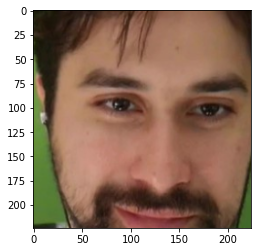

/content/drive/MyDrive/PS/final_ds/WOL_0022.jpg
282


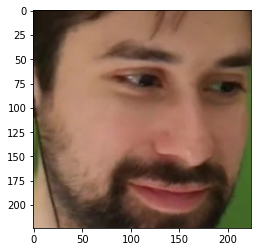

/content/drive/MyDrive/PS/final_ds/WOL_0023.jpg
283


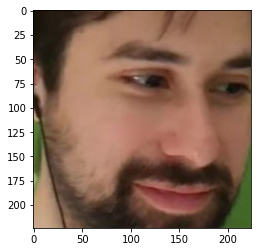

/content/drive/MyDrive/PS/final_ds/WOL_0024.jpg
284


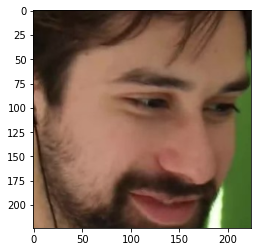

/content/drive/MyDrive/PS/final_ds/WOL_0025.jpg
285


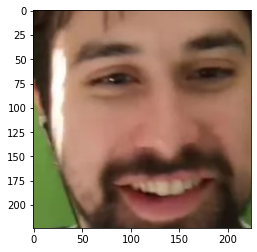

/content/drive/MyDrive/PS/final_ds/WOL_0026.jpg
286


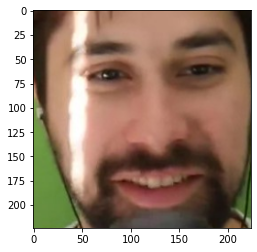

/content/drive/MyDrive/PS/final_ds/WOL_0027.jpg
287


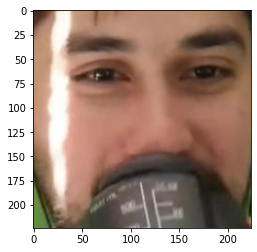

/content/drive/MyDrive/PS/final_ds/WOL_0028.jpg
288


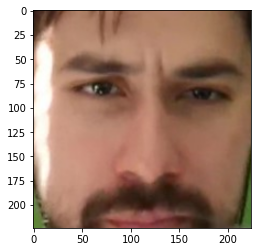

/content/drive/MyDrive/PS/final_ds/WOL_0029.jpg
289


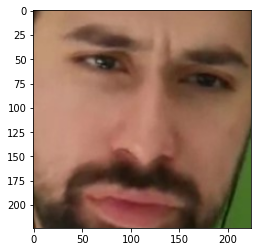

/content/drive/MyDrive/PS/final_ds/WOL_0030.jpg
290


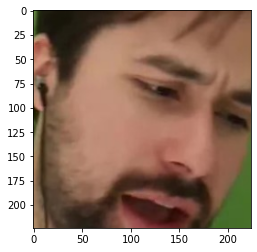

/content/drive/MyDrive/PS/final_ds/Zunacorn_08.jpg
291


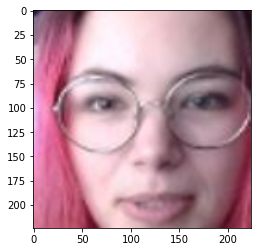

/content/drive/MyDrive/PS/final_ds/Zunacorn_09.jpg
292


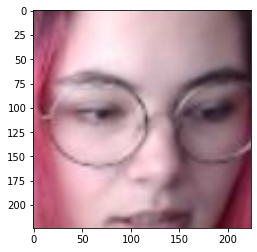

/content/drive/MyDrive/PS/final_ds/Zunacorn_10.jpg
293


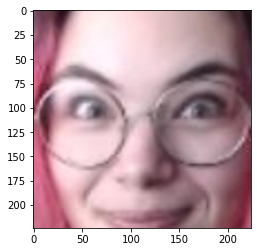

In [ ]:
x_train=[]
y_train=[]
numers_errors = 0
for i in range(len(train_learn)):
  try:
    file_name = train_learn.name.iloc[i]
    print(path +"final_ds/"+file_name)
    print(i)
    img=cv2.imread(path +"final_ds/" +file_name)
    gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rects=dnnFaceDetector(gray,1)
    left,top,right,bottom=0,0,0,0
    for (j,rect) in enumerate(rects):
        left=rect.rect.left() #x1
        top=rect.rect.top() #y1
        right=rect.rect.right() #x2
        bottom=rect.rect.bottom() #y2
        break
    if left < 0:
        left = 0
    if top < 0:
        top = 0
    width=right-left
    height=bottom-top
    img_crop=img[top:top+height,left:left+width]
    img = cv2.resize(img_crop,(224,224))
    plot(img)
    img=img_to_array(img)
    img=np.expand_dims(img,axis=0)
    img=preprocess_input(img)
    img_encode=vgg_face(img)
    x_train.append(np.squeeze(K.eval(img_encode)).tolist())
    y_train.append(train_learn.cls.iloc[i])
  except:
    numers_errors +=1

In [ ]:
!nvidia-smi

In [ ]:
numers_errors

7

In [ ]:
y_train

[162,
 162,
 162,
 163,
 163,
 163,
 3,
 3,
 3,
 164,
 164,
 164,
 6,
 6,
 5,
 7,
 7,
 7,
 8,
 8,
 8,
 9,
 12,
 12,
 12,
 11,
 11,
 11,
 22,
 22,
 22,
 24,
 24,
 24,
 170,
 170,
 170,
 25,
 25,
 25,
 171,
 171,
 171,
 30,
 30,
 30,
 30,
 30,
 32,
 32,
 32,
 32,
 32,
 36,
 36,
 36,
 36,
 36,
 38,
 38,
 38,
 38,
 38,
 42,
 42,
 42,
 42,
 44,
 44,
 44,
 44,
 44,
 48,
 48,
 48,
 48,
 48,
 50,
 50,
 50,
 50,
 50,
 54,
 54,
 54,
 54,
 54,
 56,
 56,
 56,
 56,
 56,
 60,
 60,
 60,
 60,
 60,
 62,
 62,
 62,
 62,
 62,
 66,
 66,
 66,
 66,
 66,
 68,
 68,
 68,
 68,
 68,
 72,
 72,
 72,
 72,
 72,
 74,
 74,
 74,
 74,
 74,
 78,
 78,
 78,
 78,
 78,
 80,
 80,
 80,
 80,
 80,
 84,
 84,
 84,
 84,
 84,
 86,
 86,
 86,
 86,
 86,
 90,
 90,
 90,
 90,
 90,
 92,
 92,
 92,
 92,
 92,
 96,
 96,
 96,
 96,
 96,
 98,
 98,
 98,
 98,
 98,
 104,
 104,
 104,
 104,
 104,
 108,
 108,
 108,
 108,
 108,
 110,
 110,
 110,
 110,
 114,
 114,
 114,
 114,
 114,
 116,
 116,
 116,
 116,
 116,
 120,
 120,
 120,
 120,
 120,
 122,
 122,
 1

In [ ]:
dic = {}
for i,n in enumerate(set(y_train)):
  dic[i]=n

In [ ]:
dic

{0: 128,
 1: 3,
 2: 132,
 3: 5,
 4: 6,
 5: 7,
 6: 8,
 7: 9,
 8: 134,
 9: 11,
 10: 12,
 11: 138,
 12: 140,
 13: 144,
 14: 146,
 15: 22,
 16: 24,
 17: 25,
 18: 154,
 19: 27,
 20: 155,
 21: 157,
 22: 30,
 23: 32,
 24: 160,
 25: 162,
 26: 163,
 27: 164,
 28: 36,
 29: 38,
 30: 161,
 31: 170,
 32: 171,
 33: 42,
 34: 44,
 35: 172,
 36: 174,
 37: 48,
 38: 50,
 39: 54,
 40: 56,
 41: 60,
 42: 62,
 43: 66,
 44: 68,
 45: 72,
 46: 74,
 47: 78,
 48: 80,
 49: 84,
 50: 86,
 51: 90,
 52: 92,
 53: 96,
 54: 98,
 55: 104,
 56: 108,
 57: 110,
 58: 114,
 59: 116,
 60: 120,
 61: 122,
 62: 126}

In [ ]:
dic2 = {v:k for k, v in dic.items()}


In [ ]:
dic2

{3: 1,
 5: 3,
 6: 4,
 7: 5,
 8: 6,
 9: 7,
 11: 9,
 12: 10,
 22: 15,
 24: 16,
 25: 17,
 27: 19,
 30: 22,
 32: 23,
 36: 28,
 38: 29,
 42: 33,
 44: 34,
 48: 37,
 50: 38,
 54: 39,
 56: 40,
 60: 41,
 62: 42,
 66: 43,
 68: 44,
 72: 45,
 74: 46,
 78: 47,
 80: 48,
 84: 49,
 86: 50,
 90: 51,
 92: 52,
 96: 53,
 98: 54,
 104: 55,
 108: 56,
 110: 57,
 114: 58,
 116: 59,
 120: 60,
 122: 61,
 126: 62,
 128: 0,
 132: 2,
 134: 8,
 138: 11,
 140: 12,
 144: 13,
 146: 14,
 154: 18,
 155: 20,
 157: 21,
 160: 24,
 161: 30,
 162: 25,
 163: 26,
 164: 27,
 170: 31,
 171: 32,
 172: 35,
 174: 36}

In [ ]:
for i in range(len(y_train)):
    y_train[i] = dic2[y_train[i]]

In [ ]:
y_train

[25,
 25,
 25,
 26,
 26,
 26,
 1,
 1,
 1,
 27,
 27,
 27,
 4,
 4,
 3,
 5,
 5,
 5,
 6,
 6,
 6,
 7,
 10,
 10,
 10,
 9,
 9,
 9,
 15,
 15,
 15,
 16,
 16,
 16,
 31,
 31,
 31,
 17,
 17,
 17,
 32,
 32,
 32,
 22,
 22,
 22,
 22,
 22,
 23,
 23,
 23,
 23,
 23,
 28,
 28,
 28,
 28,
 28,
 29,
 29,
 29,
 29,
 29,
 33,
 33,
 33,
 33,
 34,
 34,
 34,
 34,
 34,
 37,
 37,
 37,
 37,
 37,
 38,
 38,
 38,
 38,
 38,
 39,
 39,
 39,
 39,
 39,
 40,
 40,
 40,
 40,
 40,
 41,
 41,
 41,
 41,
 41,
 42,
 42,
 42,
 42,
 42,
 43,
 43,
 43,
 43,
 43,
 44,
 44,
 44,
 44,
 44,
 45,
 45,
 45,
 45,
 45,
 46,
 46,
 46,
 46,
 46,
 47,
 47,
 47,
 47,
 47,
 48,
 48,
 48,
 48,
 48,
 49,
 49,
 49,
 49,
 49,
 50,
 50,
 50,
 50,
 50,
 51,
 51,
 51,
 51,
 51,
 52,
 52,
 52,
 52,
 52,
 53,
 53,
 53,
 53,
 53,
 54,
 54,
 54,
 54,
 54,
 55,
 55,
 55,
 55,
 55,
 56,
 56,
 56,
 56,
 56,
 57,
 57,
 57,
 57,
 58,
 58,
 58,
 58,
 58,
 59,
 59,
 59,
 59,
 59,
 60,
 60,
 60,
 60,
 60,
 61,
 61,
 61,
 61,
 61,
 62,
 62,
 62,
 62,
 62,
 0,
 0,
 0,

In [ ]:
x_test_train=[]
y_test_train=[]
numers_errors = 0
for i in range(len(train_test)):
  try:
    file_name = train_test.name.iloc[i]
    print(path +"final_ds/"+file_name)
    print(i)
    img=cv2.imread(path +"final_ds/" +file_name)
    img=cv2.imread(path +"final_ds/" +file_name)
    gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rects=dnnFaceDetector(gray,1)
    left,top,right,bottom=0,0,0,0
    for (j,rect) in enumerate(rects):
        left=rect.rect.left() #x1
        top=rect.rect.top() #y1
        right=rect.rect.right() #x2
        bottom=rect.rect.bottom() #y2
        break
    if left < 0:
        left = 0
    if top < 0:
        top = 0
    width=right-left
    height=bottom-top
    img_crop=img[top:top+height,left:left+width]
    img = cv2.resize(img_crop,(224,224))
    plot(img)
    img=img_to_array(img)
    img=np.expand_dims(img,axis=0)
    img=preprocess_input(img)
    img_encode=vgg_face(img)
    x_test_train.append(np.squeeze(K.eval(img_encode)).tolist())
    y_test_train.append(train_test.cls.iloc[i])
  except:
    numers_errors +=1

In [ ]:
numers_errors

4

In [ ]:
len(y_test_train)

366

In [ ]:
y_test_train

[162,
 162,
 162,
 162,
 162,
 162,
 162,
 163,
 163,
 163,
 163,
 163,
 163,
 163,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 164,
 164,
 164,
 164,
 164,
 164,
 164,
 5,
 6,
 6,
 6,
 6,
 6,
 6,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 9,
 12,
 12,
 12,
 12,
 12,
 12,
 12,
 11,
 11,
 11,
 11,
 11,
 11,
 11,
 22,
 22,
 22,
 22,
 22,
 22,
 22,
 24,
 24,
 24,
 24,
 24,
 24,
 24,
 170,
 170,
 170,
 170,
 170,
 170,
 170,
 25,
 25,
 25,
 25,
 25,
 25,
 25,
 171,
 171,
 171,
 171,
 171,
 171,
 171,
 30,
 30,
 30,
 30,
 30,
 32,
 32,
 32,
 32,
 32,
 36,
 36,
 36,
 36,
 36,
 38,
 38,
 38,
 38,
 38,
 42,
 42,
 42,
 42,
 44,
 44,
 44,
 44,
 44,
 48,
 48,
 48,
 48,
 48,
 50,
 50,
 50,
 50,
 50,
 54,
 54,
 54,
 54,
 54,
 56,
 56,
 56,
 56,
 56,
 60,
 60,
 60,
 60,
 60,
 62,
 62,
 62,
 62,
 62,
 66,
 66,
 66,
 66,
 66,
 68,
 68,
 68,
 68,
 68,
 72,
 72,
 72,
 72,
 72,
 74,
 74,
 74,
 74,
 74,
 78,
 78,
 78,
 78,
 78,
 80,
 80,
 80,
 80,
 80,
 84,
 84,
 84,
 84,
 84,
 86,
 86,
 86,
 86,
 86,
 90,

In [ ]:
y_test_train_edit = []
x_test_train_edit = []

for i in range(len(y_test_train)):
  if y_test_train[i] in dic2:
      y_test_train_edit.append(y_test_train[i])
      x_test_train_edit.append(x_test_train[i])
  else:
      print(y_test_train[i])
y_test_train = y_test_train_edit
x_test_train = x_test_train_edit

102
102


In [ ]:
for i in range(len(y_test_train)):
    y_test_train[i] = dic2[y_test_train[i]]

In [ ]:
print(y_test_train)

[25, 25, 25, 25, 25, 25, 25, 26, 26, 26, 26, 26, 26, 26, 1, 1, 1, 1, 1, 1, 1, 27, 27, 27, 27, 27, 27, 27, 3, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 7, 10, 10, 10, 10, 10, 10, 10, 9, 9, 9, 9, 9, 9, 9, 15, 15, 15, 15, 15, 15, 15, 16, 16, 16, 16, 16, 16, 16, 31, 31, 31, 31, 31, 31, 31, 17, 17, 17, 17, 17, 17, 17, 32, 32, 32, 32, 32, 32, 32, 22, 22, 22, 22, 22, 23, 23, 23, 23, 23, 28, 28, 28, 28, 28, 29, 29, 29, 29, 29, 33, 33, 33, 33, 34, 34, 34, 34, 34, 37, 37, 37, 37, 37, 38, 38, 38, 38, 38, 39, 39, 39, 39, 39, 40, 40, 40, 40, 40, 41, 41, 41, 41, 41, 42, 42, 42, 42, 42, 43, 43, 43, 43, 43, 44, 44, 44, 44, 44, 45, 45, 45, 45, 45, 46, 46, 46, 46, 46, 47, 47, 47, 47, 47, 48, 48, 48, 48, 48, 49, 49, 49, 49, 49, 50, 50, 50, 50, 50, 51, 51, 51, 51, 51, 52, 52, 52, 52, 52, 53, 53, 53, 53, 53, 54, 54, 54, 54, 54, 55, 55, 55, 55, 55, 56, 56, 56, 56, 56, 57, 57, 57, 57, 57, 58, 58, 58, 58, 58, 59, 59, 59, 59, 59, 60, 60, 60, 60, 60, 61, 61, 61, 61, 61, 62, 62, 62, 62, 62, 0, 

In [ ]:
np.save(path+'train_data',x_train)
np.save(path+'train_labels',y_train)
np.save(path+'test_data',x_test_train)
np.save(path+'test_labels',y_test_train)
# Load saved data
x_train=np.load(path+'train_data.npy')
y_train=np.load(path+'train_labels.npy')
x_test_train=np.load(path+'test_data.npy')
y_test_train=np.load(path+'test_labels.npy')

In [ ]:
x_train=np.load(path+'train_data.npy')
y_train=np.load(path+'train_labels.npy')
x_test_train=np.load(path+'test_data.npy')
y_test_train=np.load(path+'test_labels.npy')

In [ ]:
x_test_train=np.load(path+'test_data.npy')
y_test_train=np.load(path+'test_labels.npy')

In [ ]:
x_train.shape[1]

2622

In [ ]:
# Softmax regressor to classify images based on encoding 
from keras.optimizers import SGD
NUMBER_COUNT = 64
classifier_model=Sequential()
classifier_model.add(BatchNormalization())
classifier_model.add(tf.keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1)))
classifier_model.add(Dense(units=2000,input_dim=x_train.shape[1],kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=2000,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=800,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=NUMBER_COUNT,kernel_initializer='he_uniform'))
classifier_model.add(Activation('sigmoid'))
classifier_model.compile(loss='sparse_categorical_crossentropy', optimizer = SGD(lr=0.01, momentum=0.9), metrics=['accuracy'])

In [ ]:
# classifier_model.summary()

In [ ]:
EPOCHS = 3
history = classifier_model.fit(x_train,y_train,epochs=EPOCHS,shuffle=True)

In [ ]:
person=classifier_model.predict(x_test_train)

In [ ]:
person

In [ ]:
ks = list(person[1])
dic[ks.index(max(ks))]

162

In [ ]:
y_predic_probob = []
y_predict = []
for i in person:
  ks = list(i)
  y_predic_probob.append(max(ks))
  y_predict.append(ks.index(max(ks)))

In [ ]:
y_predict

[26,
 25,
 26,
 26,
 26,
 10,
 10,
 26,
 26,
 26,
 26,
 26,
 26,
 26,
 1,
 1,
 1,
 26,
 1,
 1,
 1,
 27,
 27,
 27,
 27,
 27,
 27,
 27,
 4,
 10,
 47,
 4,
 4,
 44,
 4,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 6,
 6,
 6,
 6,
 6,
 6,
 6,
 40,
 10,
 10,
 10,
 10,
 10,
 10,
 10,
 10,
 9,
 10,
 10,
 10,
 10,
 26,
 15,
 15,
 15,
 15,
 15,
 15,
 15,
 13,
 2,
 13,
 2,
 16,
 2,
 16,
 31,
 31,
 31,
 31,
 31,
 24,
 31,
 17,
 17,
 17,
 17,
 17,
 17,
 17,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 40,
 22,
 22,
 22,
 22,
 23,
 23,
 23,
 23,
 23,
 28,
 28,
 28,
 28,
 2,
 29,
 29,
 29,
 29,
 29,
 40,
 40,
 43,
 2,
 34,
 34,
 34,
 34,
 40,
 57,
 42,
 24,
 42,
 37,
 40,
 2,
 40,
 38,
 38,
 38,
 43,
 42,
 41,
 2,
 40,
 40,
 40,
 40,
 40,
 41,
 41,
 41,
 41,
 41,
 42,
 42,
 42,
 42,
 42,
 43,
 43,
 43,
 43,
 43,
 44,
 44,
 44,
 44,
 44,
 45,
 45,
 45,
 45,
 45,
 46,
 46,
 46,
 46,
 46,
 47,
 47,
 47,
 47,
 47,
 48,
 48,
 48,
 48,
 48,
 40,
 49,
 49,
 40,
 40,
 40,
 40,
 13,
 35,
 40,
 51,
 51,
 51,
 51,
 51,
 52,
 52,
 52,
 5

In [ ]:
y_test_train

array([25, 25, 25, 25, 25, 25, 25, 26, 26, 26, 26, 26, 26, 26,  1,  1,  1,
        1,  1,  1,  1, 27, 27, 27, 27, 27, 27, 27,  3,  4,  4,  4,  4,  4,
        4,  5,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  7, 10,
       10, 10, 10, 10, 10, 10,  9,  9,  9,  9,  9,  9,  9, 15, 15, 15, 15,
       15, 15, 15, 16, 16, 16, 16, 16, 16, 16, 31, 31, 31, 31, 31, 31, 31,
       17, 17, 17, 17, 17, 17, 17, 32, 32, 32, 32, 32, 32, 32, 22, 22, 22,
       22, 22, 23, 23, 23, 23, 23, 28, 28, 28, 28, 28, 29, 29, 29, 29, 29,
       33, 33, 33, 33, 34, 34, 34, 34, 34, 37, 37, 37, 37, 37, 38, 38, 38,
       38, 38, 39, 39, 39, 39, 39, 40, 40, 40, 40, 40, 41, 41, 41, 41, 41,
       42, 42, 42, 42, 42, 43, 43, 43, 43, 43, 44, 44, 44, 44, 44, 45, 45,
       45, 45, 45, 46, 46, 46, 46, 46, 47, 47, 47, 47, 47, 48, 48, 48, 48,
       48, 49, 49, 49, 49, 49, 50, 50, 50, 50, 50, 51, 51, 51, 51, 51, 52,
       52, 52, 52, 52, 53, 53, 53, 53, 53, 54, 54, 54, 54, 54, 55, 55, 55,
       55, 55, 56, 56, 56

In [ ]:
y_predic_probob

[0.64275306,
 0.6504615,
 0.6460287,
 0.64336497,
 0.63923246,
 0.6737607,
 0.6411962,
 0.7530608,
 0.7377,
 0.73357356,
 0.73558855,
 0.7393885,
 0.74877924,
 0.75746715,
 0.6559262,
 0.6661031,
 0.6347545,
 0.6241347,
 0.67021185,
 0.6503447,
 0.66462004,
 0.71795106,
 0.663496,
 0.7218929,
 0.73486304,
 0.7166498,
 0.7206361,
 0.7220832,
 0.6293829,
 0.65550655,
 0.6279178,
 0.6176294,
 0.62610114,
 0.6163661,
 0.63392866,
 0.68392247,
 0.6910976,
 0.6806491,
 0.6732133,
 0.6459388,
 0.6971999,
 0.6822991,
 0.7480056,
 0.7325007,
 0.7023954,
 0.7172889,
 0.7384764,
 0.7315584,
 0.73317015,
 0.6530027,
 0.7339012,
 0.7211783,
 0.7435682,
 0.74328274,
 0.7216297,
 0.7309992,
 0.70757407,
 0.6780766,
 0.63938904,
 0.695096,
 0.6903846,
 0.68527985,
 0.63699895,
 0.6299232,
 0.7157602,
 0.6972789,
 0.68811536,
 0.7054083,
 0.67579246,
 0.70469743,
 0.70862436,
 0.6812022,
 0.6742865,
 0.6300795,
 0.6998878,
 0.6787679,
 0.6651312,
 0.6735298,
 0.6432391,
 0.6706732,
 0.6574928,
 0.65957

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test_train, y_predict)

0.7967032967032966

In [ ]:
tres_hold = 0.65
predict = [1 if i >=tres_hold else 0 for i in y_predic_probob]


In [ ]:
print("True_posetive= ",predict.count(1))
print("False_posetive= ",predict.count(0))
print("True_posetive= ",predict.count(1)/ len(predict))
print("False_posetive= ",predict.count(0)/ len(predict))

True_posetive=  304
False_posetive=  60
True_posetive=  0.8351648351648352
False_posetive=  0.16483516483516483


Ошибочные

In [ ]:
TEST

,name,test,white,cls
10,ALE_0001.jpg,0.0,1.0,1
11,ALE_0002.jpg,1.0,1.0,1
12,ALE_0003.jpg,1.0,1.0,1
13,ALE_0004.jpg,0.0,1.0,1
14,ALE_0005.jpg,1.0,1.0,1
...,...,...,...,...
2150,windy31_06.jpg,1.0,1.0,175
2151,windy31_07.jpg,1.0,1.0,175
2152,windy31_08.jpg,0.0,1.0,175
2153,windy31_09.jpg,0.0,1.0,175


In [ ]:
XX=[]
YY=[]
numers_errors = 0
for i in range(1000):
  try:
    file_name = TEST.name.iloc[i]
    print(path +"final_ds/"+file_name)
    print(i)
    img=cv2.imread(path +"final_ds/" +file_name)
    img=cv2.imread(path +"final_ds/" +file_name)
    gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rects=dnnFaceDetector(gray,1)
    left,top,right,bottom=0,0,0,0
    for (j,rect) in enumerate(rects):
        left=rect.rect.left() #x1
        top=rect.rect.top() #y1
        right=rect.rect.right() #x2
        bottom=rect.rect.bottom() #y2
        break
    if left < 0:
        left = 0
    if top < 0:
        top = 0
    width=right-left
    height=bottom-top
    img_crop=img[top:top+height,left:left+width]
    img = cv2.resize(img_crop,(224,224))
    plot(img)
    img=img_to_array(img)
    img=np.expand_dims(img,axis=0)
    img=preprocess_input(img)
    img_encode=vgg_face(img)
    XX.append(np.squeeze(K.eval(img_encode)).tolist())
    YY.append(TEST.cls.iloc[i])
  except:
    numers_errors +=1

In [ ]:
numers_errors

26

In [ ]:
YY

In [ ]:
np.save(path+'test_DATAXXXX',XX)

In [ ]:
len(XX)


974

In [ ]:
path

'/content/drive/MyDrive/PS/'

In [ ]:
XX = np.load(path+'test_DATAXXXX.npy')

In [ ]:
person_XX=classifier_model.predict(XX)

In [ ]:
person_XX[0]

array([0.51218784, 0.5857751 , 0.42454472, 0.49222577, 0.59068453,
       0.57410455, 0.59657925, 0.40776196, 0.4167826 , 0.55952096,
       0.6035726 , 0.5096705 , 0.45591816, 0.51408905, 0.5924574 ,
       0.52288544, 0.40382847, 0.51314414, 0.44910333, 0.50433785,
       0.3933617 , 0.49735367, 0.43674943, 0.5363131 , 0.4633692 ,
       0.5424077 , 0.5795695 , 0.5281242 , 0.50465226, 0.6192947 ,
       0.46178403, 0.5457337 , 0.44221312, 0.41416848, 0.4193535 ,
       0.45389727, 0.5403615 , 0.50006866, 0.4338392 , 0.32595396,
       0.54591376, 0.4782452 , 0.46620628, 0.37107462, 0.5613505 ,
       0.5396282 , 0.55896837, 0.57070833, 0.47557282, 0.4632229 ,
       0.4212543 , 0.5406102 , 0.5562357 , 0.50743157, 0.48348913,
       0.5068567 , 0.46598044, 0.52950126, 0.5075251 , 0.552062  ,
       0.41756073, 0.5880105 , 0.50600463, 0.49338123], dtype=float32)

In [ ]:
y_predic_probob_ = []
y_predict_ = []
for i in person_XX:
  ks = list(i)
  y_predic_probob_.append(max(ks))
  y_predict_.append(ks.index(max(ks)))

In [ ]:
len(y_predic_probob_)

974

In [ ]:
predict_ = [1 if i >=tres_hold else 0 for i in y_predic_probob_]
print("FalseNegative= ",predict_.count(1))
print("TrueNegativebin= ",predict_.count(0))
print("FalseNegative= ",predict_.count(1)/ len(predict_))
print("TrueNegativebin= ",predict_.count(0)/ len(predict_))

FalseNegative=  288
TrueNegativebin=  686
FalseNegative=  0.29568788501026694
TrueNegativebin=  0.704312114989733


True_posetive=  294

False_posetive=  76

FalseNegative=  444

TrueNegativebin=  1108

True_posetive=  0.795

False_posetive=  0.205


FalseNegative=  0.286

TrueNegativebin=  0.714

# Предсказание по фотографии

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os
import glob
import pandas as pd
import numpy as np
path='/content/drive/MyDrive/PS/' # Папка с фотографиями и весами
! wget http://dlib.net/files/mmod_human_face_detector.dat.bz2
!bzip2 -dk mmod_human_face_detector.dat.bz2
%rm mmod_human_face_detector.dat.bz2
import cv2
import matplotlib.pyplot as plt
import dlib
dnnFaceDetector = dlib.cnn_face_detection_model_v1(path + "mmod_human_face_detector.dat") # файл с весами для детектора mmod_human_face_detector

Mounted at /content/drive
--2021-04-26 20:21:42--  http://dlib.net/files/mmod_human_face_detector.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 694709 (678K)
Saving to: ‘mmod_human_face_detector.dat.bz2’

mmod_human_face_det 100%[===================>] 678.43K  1.35MB/s    in 0.5s    

2021-04-26 20:21:42 (1.35 MB/s) - ‘mmod_human_face_detector.dat.bz2’ saved [694709/694709]



In [ ]:
import matplotlib.pyplot as plt
!pip install gdown
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import ZeroPadding2D,Convolution2D,MaxPooling2D
from tensorflow.keras.layers import Dense,Dropout,Softmax,Flatten,Activation,BatchNormalization
from tensorflow.keras.preprocessing.image import load_img,img_to_array
from tensorflow.keras.applications.imagenet_utils import preprocess_input
import tensorflow.keras.backend as K
model = Sequential()
model.add(ZeroPadding2D((1,1),input_shape=(224,224, 3)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(Convolution2D(4096, (7, 7), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(4096, (1, 1), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(2622, (1, 1)))
model.add(Flatten())
model.add(Activation('softmax'))
model.load_weights('/content/drive/My Drive/Colab Notebooks/Face_Recognition/archive/' + 'vgg_face_weights.h5') # путь к фалу с весами для сети VGG-Face
model.summary()
vgg_face=Model(inputs=model.layers[0].input,outputs=model.layers[-2].output)
# vgg_face.summary()
from keras.optimizers import SGD
NUMBER_COUNT = 64
classifier_model=Sequential()
classifier_model.add(BatchNormalization())
classifier_model.add(tf.keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1)))
classifier_model.add(Dense(units=2000,input_dim=x_train.shape[1],kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=2000,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=800,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=NUMBER_COUNT,kernel_initializer='he_uniform'))
classifier_model.add(Activation('sigmoid'))
classifier_model.compile(loss='sparse_categorical_crossentropy', optimizer = SGD(lr=0.01, momentum=0.9), metrics=['accuracy'])

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
zero_padding2d_13 (ZeroPaddi (None, 226, 226, 3)       0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 224, 224, 64)      1792      
_________________________________________________________________
zero_padding2d_14 (ZeroPaddi (None, 226, 226, 64)      0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 224, 224, 64)      36928     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 112, 112, 64)      0         
_________________________________________________________________
zero_padding2d_15 (ZeroPaddi (None, 114, 114, 64)      0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 112, 112, 128)    

In [ ]:
os.chdir(path+ 'final_ds')
DATASET = pd.read_csv( path+ 'final_ds/final.csv')

In [ ]:
tres_hold = 0.65

In [ ]:
DATASET =  DATASET.rename({'class': 'cls'}, axis=1)

TRAIN = DATASET[DATASET['white'] == 0]
TEST = DATASET[DATASET['white'] == 1]
train_learn = TRAIN[TRAIN['test'] == 0] # фотографии на которых обучаемся
train_test  = TRAIN[TRAIN['test'] == 1]

In [ ]:
train_learn_list = list(train_learn.name)

In [ ]:
def plot(img):
  plt.figure(figsize=(8,4))
  plt.imshow(img[:,:,::-1])
  plt.show()

In [ ]:
def train(train_learn):
    x_train=[]
    y_train=[]
    numers_errors = 0
    for i in range(len(train_learn)):
      try:
        file_name = train_learn.name.iloc[i]
        print(path +"final_ds/"+file_name)
        print(i)
        img=cv2.imread(path +"final_ds/" +file_name)
        gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        rects=dnnFaceDetector(gray,1)
        left,top,right,bottom=0,0,0,0
        for (j,rect) in enumerate(rects):
            left=rect.rect.left() #x1
            top=rect.rect.top() #y1
            right=rect.rect.right() #x2
            bottom=rect.rect.bottom() #y2
            break
        if left < 0:
            left = 0
        if top < 0:
            top = 0
        width=right-left
        height=bottom-top
        img_crop=img[top:top+height,left:left+width]
        img = cv2.resize(img_crop,(224,224))
        plot(img)
        img=img_to_array(img)
        img=np.expand_dims(img,axis=0)
        img=preprocess_input(img)
        img_encode=vgg_face(img)
        x_train.append(np.squeeze(K.eval(img_encode)).tolist())
        y_train.append(train_learn.cls.iloc[i])
      except:
        numers_errors +=1
    return x_train, y_train

In [ ]:
x_train, y_train = train(train_learn)

In [ ]:
y_train

In [ ]:
dic = {}
for i,n in enumerate(set(y_train)):
  dic[i]=n
dic2 = {v:k for k, v in dic.items()}

In [ ]:
for i in range(len(y_train)):
    y_train[i] = dic2[y_train[i]]

In [ ]:
from keras.optimizers import SGD
NUMBER_COUNT = len(y_train)
classifier_model=Sequential()
classifier_model.add(BatchNormalization())
classifier_model.add(tf.keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1)))
classifier_model.add(Dense(units=2000,input_dim=2622,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=2000,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=800,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.05))
classifier_model.add(Dense(units=NUMBER_COUNT,kernel_initializer='he_uniform'))
classifier_model.add(Activation('sigmoid'))
classifier_model.compile(loss='sparse_categorical_crossentropy', optimizer = SGD(lr=0.01, momentum=0.9), metrics=['accuracy'])

In [ ]:
EPOCHS = 3
history = classifier_model.fit(x_train,y_train,epochs=EPOCHS,shuffle=True)

Epoch 1/3
9/9 [==============================] - 1s 7ms/step - loss: 3.6003 - accuracy: 0.2132
Epoch 2/3
9/9 [==============================] - 0s 6ms/step - loss: 0.1262 - accuracy: 0.9749
Epoch 3/3
9/9 [==============================] - 0s 7ms/step - loss: 0.0895 - accuracy: 0.9660


In [ ]:
def predict(phot):
  encod_x = []
  try:
    file_name = phot
    print(phot)
    img=cv2.imread(file_name)
    gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rects=dnnFaceDetector(gray,1)
    left,top,right,bottom=0,0,0,0
    for (j,rect) in enumerate(rects):
        left=rect.rect.left() #x1
        top=rect.rect.top() #y1
        right=rect.rect.right() #x2
        bottom=rect.rect.bottom() #y2
        break
    if left < 0:
        left = 0
    if top < 0:
        top = 0
    width=right-left
    height=bottom-top
    img_crop=img[top:top+height,left:left+width]
    img = cv2.resize(img_crop,(224,224))
    plot(img)
    img=img_to_array(img)
    img=np.expand_dims(img,axis=0)
    img=preprocess_input(img)
    img_encode=vgg_face(img)
    encod_x.append(np.squeeze(K.eval(img_encode)).tolist())
  except:
    numers_errors +=1
  person_XX=classifier_model.predict(encod_x)
  y_predic_probob_ = []
  for i in person_XX:
      ks = list(i)
      y_predic_probob_.append(max(ks))
  predict_ = [1 if i >=tres_hold else 0 for i in y_predic_probob_]
  if predict_[0] == 0:
      print("Не принадлежит белому списку")
  else:
      print("Принадлежит белому списку")
  return predict_


/content/drive/MyDrive/PS/final_ds/agadmators_01.jpg


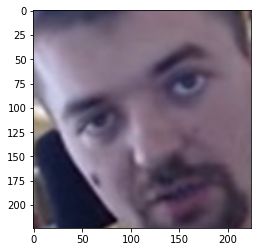

Не принадлежит белому списку


[0]

In [ ]:
predict(path +"final_ds/"+'agadmators_01.jpg')